Importing Libraries

In [6]:
# Importing Libs..

import os
from glob import glob

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from keras.utils.np_utils import to_categorical # convert to one-hot-encoding

import tensorflow
import keras

from keras.applications import VGG16
from keras.applications import ResNet50
from keras.applications import InceptionV3
from keras.applications import InceptionResNetV2
from keras.applications import Xception
from keras.applications import DenseNet201

from keras.models import Model, load_model
from keras.preprocessing import image
from keras.models import Model, Input
from keras.layers import BatchNormalization, Dropout, Conv2D, MaxPooling2D, GlobalAveragePooling2D, Flatten, Dense

from keras.models import Sequential
from keras import layers
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau, EarlyStopping,ModelCheckpoint
from keras import backend as K
from keras.utils import plot_model

%matplotlib inline
import matplotlib.pyplot as plt

In [7]:
import cv2
import seaborn as sns
import gc

from sklearn.metrics import cohen_kappa_score, accuracy_score
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.metrics import roc_auc_score,precision_recall_fscore_support
import scipy

In [8]:
import keras.backend as k
from tensorflow.compat.v1.keras.backend import set_session
from tensorflow.compat.v1.keras.backend import clear_session
from tensorflow.compat.v1.keras.backend import get_session


## Load  Dataset

In [9]:
y = np.load('/Volumes/surya/aptos2019-blindness-detection/y_train.npy')
x = np.load('/Volumes/surya/aptos2019-blindness-detection/X_train_256.npy')
x_test_pred = np.load('/Volumes/surya/aptos2019-blindness-detection/X_test_256.npy')

In [10]:
test = pd.read_csv('/Volumes/surya/aptos2019-blindness-detection/test.csv')

In [11]:
from sklearn.model_selection import train_test_split
x_train_o, x_test, y_train_o, y_test = train_test_split(x, y,test_size = 0.10,random_state=42)

In [12]:
x_train_o.shape,x_test.shape, y_train_o.shape, y_test.shape

((8122, 256, 256, 3), (903, 256, 256, 3), (8122, 5), (903, 5))

In [165]:
x_train, x_val, y_train, y_val = train_test_split(x_train_o, y_train_o,test_size = 0.15,random_state=42)

In [166]:
x_train.shape,x_val.shape, y_train.shape, y_val.shape

((6903, 256, 256, 3), (1219, 256, 256, 3), (6903, 5), (1219, 5))

((6903, 256, 256, 3), (1219, 256, 256, 3), (6903, 5), (1219, 5))

In [9]:
initial_epochs=3
batch_size=32
fine_tune_epochs=40

In [10]:

# Reset Keras Session
def reset_keras():
    sess = get_session()
    clear_session()
    sess.close()
    sess = get_session()

    try:
        del classifier # this is from global space - change this as you need
    except:
        pass

    print(gc.collect()) # if it does something you should see a number as output

    # use the same config as you used to create the session
    config = tensorflow.compat.v1.ConfigProto()
    config.gpu_options.per_process_gpu_memory_fraction = 1
    config.gpu_options.visible_device_list = "0"
    set_session(tensorflow.compat.v1.Session(config=config))

In [11]:
from keras.preprocessing.image import ImageDataGenerator

train_data_gen = ImageDataGenerator(
        width_shift_range=0.2, height_shift_range=0.2,
        horizontal_flip=True,   # randomly flip images
        vertical_flip=True,     # randomly flip images
        rotation_range=60 ,      # Degree range for random rotations
        zoom_range=0.2, shear_range=0.2, fill_mode='nearest')

valid_data_gen = ImageDataGenerator()

# Using original generator
train_generator = train_data_gen.flow(x_train, y_train,batch_size=batch_size,seed=2019)

valid_generator = valid_data_gen.flow(x_val, y_val,batch_size=batch_size,seed=2019)

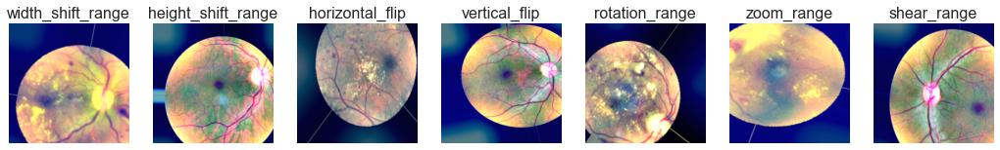

In [142]:
fig,ax=plt.subplots(nrows=1,ncols=7,figsize=(18,8))
i = 0
aug = ['width_shift_range','height_shift_range','horizontal_flip','vertical_flip','rotation_range','zoom_range','shear_range']
#for img_iterator in datagen.flow(x = img_arr,batch_size = 1):
for x,y in train_data_gen.flow(x_train, y_train): 
    ax[i].set_title("{}".format(aug[i]), size=16)
    ax[i].imshow((x[0].astype('uint8'))) 
    ax[i].axis('off')  
    
    i = i + 1
    if i == 7:
        break
#fig.savefig("images_pre/Aug_21.png",dpi=96)

In [145]:
train = pd.read_csv('/Volumes/surya/aptos2019-blindness-detection/train.csv')

In [146]:
train['image'] = [i + '.png' for i in train['id_code']]

In [147]:

TRAIN_PATH ='/Volumes/surya/aptos2019-blindness-detection/train-final-256/' 
train['file_path'] = train['id_code'].map(lambda x: os.path.join(TRAIN_PATH,'{}.png'.format(x)))

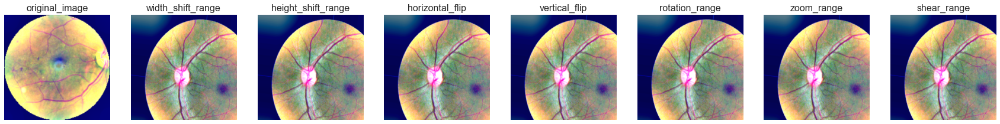

In [156]:
fig,ax=plt.subplots(nrows=1,ncols=8,figsize=(30,10))
i = 0
img = cv2.imread(train.file_path.iloc[np.random.randint(low = 0,high = len(train) - 1)])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = cv2.resize(img, (256,256))
img_arr = img.reshape((1,) + img.shape)
ax[i].set_title("original_image", size=16)
ax[i].imshow(img)
ax[i].axis("off")
# plt.rcParams["axes.grid"] = False
i = i + 1
aug = ['width_shift_range','height_shift_range','horizontal_flip','vertical_flip','rotation_range','zoom_range','shear_range']
for img_iterator in train_data_gen.flow(x = img_arr,batch_size = 1):
# for x,y in train_data_gen.flow(x_train, y_train): 
    ax[i].set_title("{}".format(aug[i-1]), size=16)
    ax[i].imshow((x[0].astype('uint8'))) 
    ax[i].axis('off')  
    
    i = i + 1
    if i == 8:
        break
#fig.savefig("images_pre/Aug_21_New.png",dpi=96)

## Load in Pretrained Models

In [12]:
vgg = keras.applications.VGG16(weights='imagenet',include_top=False, input_shape=(256,256,3))
resnet=keras.applications.ResNet50(weights='imagenet',include_top=False, input_shape=(256,256,3)) 
densenet=keras.applications.DenseNet201(weights='imagenet',include_top=False, input_shape=(256,256,3))
inceptnet=keras.applications.InceptionV3(weights='imagenet',include_top=False, input_shape=(256,256,3))
incept_resnet=keras.applications.InceptionResNetV2(weights='imagenet',include_top=False, input_shape=(256,256,3))
xceptnet=keras.applications.Xception(weights='imagenet',include_top=False, input_shape=(256,256,3))

## Define & Train the Model

### Feature-Extraction

If performing fine tuning directly would result in a huge gradient, so it's better that we perform 3 epochs of feature extraction first so that weights of the final fully connected layer aren't completely random. The intuition for this is that if we don't perform feature-extraction, then the gradient will be too large and will change the pretrained weights too much.


In [13]:
def Initial_Training_1(base_model,name):

    for layer in base_model.layers:
        print(layer.name)
        layer.trainable = False
        
    print(len(base_model.layers))
   

    # Get the output from the base model 
    base_model_ouput = base_model.layers[-1].output

    x = layers.BatchNormalization()(base_model_ouput)
    # Flatten the output layer to 1 dimension
    x = layers.GlobalAveragePooling2D()(x)
    # Add a fully connected layer with 1024 hidden units and ReLU activation
    x = layers.Dense(1024, activation='relu')(x)
     # Add a dropout rate of 0.5
    x = layers.Dropout(0.5)(x)
    # Add a fully connected layer with 1024 hidden units and ReLU activation
    x = layers.Dense(512, activation='relu')(x)
    # Add a dropout rate of 0.5
    x = layers.Dropout(0.5)(x)
    # Add a final sigmoid layer for classification
    x = layers.Dense(5, activation='softmax')(x)

    # Configure and compile the model

    model = Model(inputs=base_model.input, outputs=x,name=name)

    optimizer = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=True)
    model.compile(loss='categorical_crossentropy',
                optimizer=optimizer,
                metrics=['accuracy'])
                
    model.summary()

    history= model.fit_generator(train_generator,
    steps_per_epoch=train_generator.n//batch_size,
    validation_data=valid_generator,
    validation_steps=valid_generator.n//batch_size,
    epochs=initial_epochs,verbose=1)
        
    return model, history

In [14]:
def Initial_Training_2(base_model,name):

  #Reset the batch norm moving averages and allow them to update to the new dataset
  
    for layer in base_model.layers:
        print(layer.name)
        if hasattr(layer, 'moving_mean') and hasattr(layer, 'moving_variance'):
            layer.trainable = True
            K.eval(K.update(layer.moving_mean, K.zeros_like(layer.moving_mean)))
            K.eval(K.update(layer.moving_variance, K.zeros_like(layer.moving_variance)))
        else:
            layer.trainable = False

    print(len(base_model.layers))

    
    # Get the output from the base model 
   
    base_model_ouput = base_model.layers[-1].output

    x = layers.BatchNormalization(name=name+'_BN')(base_model_ouput)
    # Flatten the output layer to 1 dimension
    x = layers.GlobalAveragePooling2D()(x)
    # Add a fully connected layer with 1024 hidden units and ReLU activation
    x = layers.Dense(1024, activation='relu')(x)
     # Add a dropout rate of 0.5
    x = layers.Dropout(0.5)(x)
    # Add a fully connected layer with 1024 hidden units and ReLU activation
    x = layers.Dense(512, activation='relu')(x)
    # Add a dropout rate of 0.5
    x = layers.Dropout(0.5)(x)
    # Add a final sigmoid layer for classification
    x = layers.Dense(5, activation='softmax')(x)

    # Configure and compile the model

    model = Model(inputs=base_model.input, outputs=x,name=name)

    optimizer = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=True)
    model.compile(loss='categorical_crossentropy',
                optimizer=optimizer,
                metrics=['accuracy'])
    model.summary()

    history= model.fit_generator(train_generator,
    steps_per_epoch=train_generator.n//batch_size,
    validation_data=valid_generator,
    validation_steps=valid_generator.n//batch_size,
    epochs=initial_epochs,
    verbose=1)
    
    
    return model, history

### Fine Tuning Model

Let's fine tune the last convolutional block of network. I only use learning_rate = 0.0001 with very high momentum = 0.9 and train for 40 epochs only so that the original weights of pretrained network won't be changed too much. learning_rate_reduction function is used and will halve the learning_rate whenever the validation accuracy plateaus for 3 epochs.

In [15]:
import time
def model_finetuning(model,batch_size,split_at,model_path):

    #epochs = 30

    # training the model after 15 layers
   
    for layer in model.layers[:split_at]: layer.trainable = False
    for layer in model.layers[split_at:]: layer.trainable = True
        
   
    # Choosing lower learning rate for fine-tuning
    # learning rate is generally 10-1000 times lower than normal learning rate when we are fine tuning the initial layers
    optimizer = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=1e-6, amsgrad=False)
    
    model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

    learning_rate_reduction = ReduceLROnPlateau(monitor='val_loss', patience=3, verbose=1, factor=0.5, 
                                                min_lr=0.000001, cooldown=3)
    checkpoint = ModelCheckpoint(model_path, monitor='val_loss', save_best_only = True, mode ='auto', verbose = 1)

    batch_size = 32
    epochs = 40
    start_time = time.time()
    history_finetune = model.fit_generator(
        train_generator,
        steps_per_epoch=train_generator.n//batch_size,
        validation_data=valid_generator,
        validation_steps=valid_generator.n//batch_size,
        epochs=fine_tune_epochs,
        verbose=1, callbacks=[learning_rate_reduction,checkpoint])
    print("\n")
    print("Time taken for training the model: {} seconds".format(np.round(time.time()-start_time,5)))
    return model,history_finetune

In [17]:
def plot_history(model_history,model_name):
    loss_list = [s for s in model_history.history.keys() if 'loss' in s and 'val' not in s]
    val_loss_list = [s for s in model_history.history.keys() if 'loss' in s and 'val' in s]
    acc_list = [s for s in model_history.history.keys() if 'accuracy' in s and 'val' not in s]
    val_acc_list = [s for s in model_history.history.keys() if 'accuracy' in s and 'val' in s]
    
    if len(loss_list) == 0:
        print('Loss is missing in history')
        return 
    
    ## As loss always exists
    epochs = range(1,len(model_history.history[loss_list[0]]) + 1)
    
    ## Loss
    #fig = plt.figure()
    plt.figure(1)
    for l in loss_list:
        plt.plot(epochs, model_history.history[l], 'b', label='Training loss')
    for l in val_loss_list:
        plt.plot(epochs, model_history.history[l], 'g', label='Validation loss')
    
    plt.title('Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    # plt.legend(['Training set', 'Validation set'], loc='best')
    plt.legend()
    plt.savefig('images/New_'+ model_name+'_loss.jpg',dpi=96)

    ## Accuracy
    plt.figure(2)
   
    for l in acc_list:
        plt.plot(epochs, model_history.history[l], 'b', label='Training accuracy' )
    for l in val_acc_list:    
        plt.plot(epochs, model_history.history[l], 'g', label='Validation accuracy')

    plt.title('Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    #plt.legend(['Training set', 'Validation set'], loc='best')
    plt.legend()
    plt.savefig('images/New_'+ model_name+'_accuracy.jpg',dpi=96)

    #plt.close(fig)
    plt.show()

In [74]:
def performace_evaluate(model):

    loss, accuracy = model.evaluate(x_train, y_train, verbose=1)
    loss_v, accuracy_v = model.evaluate(x_val, y_val, verbose=1)
    print("Validation: accuracy = %f  ;  loss_v = %f" % (accuracy_v, loss_v))
    print("Train: accuracy = %f  ;  loss = %f" % (accuracy, loss))

    # Make a prediction on the test set
    start_time = time.time()
    y_pred = model.predict(x_val)
    print("\n")
    print("Time taken for predicting the model: {} seconds".format(np.round(time.time()-start_time,5)))
    y_pred1 = np.round(y_pred)

    #y_pred_class = np.argmax(y_pred1,axis = 1)
    y_pred_class = np.argmax(y_pred,axis = 1)

    y_true = np.argmax(y_val,axis = 1) 

    cm = confusion_matrix(y_true,y_pred_class)
    print("\n Confusion Matrix \n")
    print(cm)

    # Check the Classification Report
    print("\n Classification Report \n")
    print(classification_report(y_val, y_pred1))
    
    #def plot_conf_matrix(true,pred,classes):
    labels = ['0 - No DR', '1 - Mild', '2 - Moderate', '3 - Severe', '4 - Proliferative DR']
    

    df_cm = pd.DataFrame(cm, range(len(labels)), range(len(labels)))
    plt.figure(figsize=(8,5.5))
    sns.set(font_scale=1.4)
    sns.heatmap(df_cm, annot=True, annot_kws={"size": 16},xticklabels = labels ,yticklabels = labels,fmt='g')
    plt.xlabel('Predicted Label')
    plt.ylabel('Actual Label')
    plt.show()

    accuracy= accuracy_score(y_true, y_pred_class)
    print('Accuracy: {}'.format(accuracy))
    precision, recall, fscore, _ = precision_recall_fscore_support(y_true, y_pred_class, average='weighted')
    print('precision: {}'.format(precision))
    print('recall: {}'.format(recall))
    print('fscore: {}'.format(fscore))


    y_predNew = y_pred.astype(int).sum(axis=1) - 1

    #from sklearn.metrics import cohen_kappa_score
    kappa_score = cohen_kappa_score(
                y_true,
                y_pred_class, 
                weights='quadratic'
            )
    print('QWK Score: {}'.format(kappa_score))


    print("\n")

    print("\n Predicting labels using validation dataset\n\n")

    #labels=['Class 0','Class 1','Class 2','Class 3','Class 4']
    labels=['No DR','Mild DR','Moderate DR','Severe DR','PDR']

    columns=4
    rows=3      

    fig, axes = plt.subplots(ncols=columns, nrows=rows, figsize=(12, 8))
    # plt.subplots_adjust(top = 0.9, bottom=0.01, hspace=1.4, wspace=0.1)#
   
    index=0
    for i in range(3):
        for j in range(4):
           
            axes[i,j].set_title("True: {}\nPredicted: {}".format(labels[y_pred_class[index]],labels[y_true[index]]),size=16)
            axes[i,j].imshow(x_val[index], cmap='gray')
            axes[i,j].get_xaxis().set_visible(False)
            axes[i,j].get_yaxis().set_visible(False)
            index += 1

    fig.tight_layout()
    plt.show()



In [76]:
def test_prediction(model):

    
     # Make a prediction on the test set
    start_time = time.time()
    y_pred = model.predict(x_test)
    print("\n")
    print("Time taken for predicting the model: {} seconds".format(np.round(time.time()-start_time,5)))
    y_pred1 = np.round(y_pred)

    #y_pred_class = np.argmax(y_pred1,axis = 1)
    y_pred_class = np.argmax(y_pred,axis = 1)

    y_true = np.argmax(y_test,axis = 1) 

    cm = confusion_matrix(y_true,y_pred_class)
    print("\n Confusion Matrix \n")
    print(cm)

    # Check the Classification Report
    print("\n Classification Report \n")
    print(classification_report(y_test, y_pred1))
    
    #def plot_conf_matrix(true,pred,classes):
    labels = ['0 - No DR', '1 - Mild', '2 - Moderate', '3 - Severe', '4 - Proliferative DR']
    

    df_cm = pd.DataFrame(cm, range(len(labels)), range(len(labels)))
    plt.figure(figsize=(8,5.5))
    sns.set(font_scale=1.4)
    sns.heatmap(df_cm, annot=True, annot_kws={"size": 16},xticklabels = labels ,yticklabels = labels,fmt='g')
    plt.xlabel('Predicted Label')
    plt.ylabel('Actual Label')
    plt.show()

    accuracy= accuracy_score(y_true, y_pred_class)
    print('Accuracy: {}'.format(accuracy))
    precision, recall, fscore, _ = precision_recall_fscore_support(y_true, y_pred_class, average='weighted')
    print('precision: {}'.format(precision))
    print('recall: {}'.format(recall))
    print('fscore: {}'.format(fscore))


    y_predNew = y_pred.astype(int).sum(axis=1) - 1

    #from sklearn.metrics import cohen_kappa_score
    kappa_score = cohen_kappa_score(
                y_true,
                y_pred_class, 
                weights='quadratic'
            )
    print('QWK Score: {}'.format(kappa_score))


    print("\n")

    print("\n Predicting labels using validation dataset\n\n")

    #labels=['Class 0','Class 1','Class 2','Class 3','Class 4']
    class_labels=['No DR','Mild DR','Moderate DR','Severe DR','PDR']

    columns=4
    rows=3      

    fig, axes = plt.subplots(ncols=columns, nrows=rows, figsize=(12, 8))
    # fig, axes = plt.subplots(ncols=4, nrows=3, figsize=(16,10))
    # plt.subplots_adjust(top = 0.9, bottom=0.01, hspace=1.4, wspace=0.2)#
 

    index=0
    for i in range(3):
        for j in range(4):
          
            axes[i,j].set_title("True: {}\nPredicted: {}".format(class_labels[y_pred_class[index]],class_labels[y_true[index]]),size=16)
            axes[i,j].imshow(x_val[index], cmap='gray')
            axes[i,j].get_xaxis().set_visible(False)
            axes[i,j].get_yaxis().set_visible(False)
            index += 1

    fig.tight_layout()
    plt.show()




In [90]:
def predict_labels(model):

    y_test = model.predict(x_test_pred,verbose=1)
    predictions = [np.argmax(pred) for pred in y_test]

    model_to_submit = pd.DataFrame({
        'id_code':test['id_code'],
        'diagnosis':predictions
    })

    print("\n Distribution of predicted label \n")
    import seaborn as sns
    import matplotlib.pyplot as plt
    f, ax = plt.subplots(figsize=(14, 8.7))
    ax = sns.countplot(x="diagnosis", data=model_to_submit, palette="GnBu_d")
    sns.despine()
    ax.set_title("Distribution of predicted label")
    plt.show()


    print("\n")

    print("\n Predicting labels using Test dataset\n\n")

    #def display_samples(df,
    columns=4
    rows=3

    fig=plt.figure(figsize=(5*columns, 4*rows))
    #fig=plt.figure(figsize=(12,8))
    #fig=plt.figure(figsize=(15, 8))
    #plt.subplots_adjust (hspace=1.4)

    for i in range(columns*rows):
        image_path = test.loc[i,'id_code']
        #print(image_path)
        image_id = model_to_submit.loc[i,'diagnosis']
        
        if image_id==0:
            val="No DR"
        elif image_id==1:
            val="Mild DR"
        elif image_id==2:
            val="Moderate DR"
        elif image_id==3:
            val="Severe DR"   
        elif image_id==4:
            val="Proliferative DR"    
        img = cv2.imread(f'G/APTOS/test-final-256/{image_path}.png')
        #print(img)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        fig.add_subplot(rows, columns, i+1)
        
        plt.title("Image={image_path}.png \nDiagnosis={image_id}".format(image_path=image_path, image_id=val),size=16)
        
        plt.axis('off')
        plt.imshow(img)

# VGG16

In [18]:
vgg_model,vgg_history= Initial_Training_1(vgg,"Vgg_1")

input_1
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_pool
19
Model: "Vgg_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 256, 256, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 256, 256, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 256, 256, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 128, 128, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 128, 128, 128)     73856     
___________________

In [19]:
vgg_FT,vgg_FT_history=model_finetuning(vgg_model,32,15,'vgg16.h5')
vgg_FT.save('vgg16_Full.h5')

Epoch 1/40
215/215 [==============================] - ETA: 0s - loss: 0.9535 - accuracy: 0.6025
Epoch 00001: val_loss improved from inf to 1.12581, saving model to Models/vgg16.h5
215/215 [==============================] - 84s 391ms/step - loss: 0.9535 - accuracy: 0.6025 - val_loss: 1.1258 - val_accuracy: 0.5444 - lr: 1.0000e-04
Epoch 2/40
215/215 [==============================] - ETA: 0s - loss: 0.8074 - accuracy: 0.6712
Epoch 00002: val_loss improved from 1.12581 to 1.04807, saving model to Models/vgg16.h5
215/215 [==============================] - 87s 404ms/step - loss: 0.8074 - accuracy: 0.6712 - val_loss: 1.0481 - val_accuracy: 0.5962 - lr: 1.0000e-04
Epoch 3/40
215/215 [==============================] - ETA: 0s - loss: 0.7486 - accuracy: 0.6993
Epoch 00003: val_loss did not improve from 1.04807
215/215 [==============================] - 85s 395ms/step - loss: 0.7486 - accuracy: 0.6993 - val_loss: 1.1625 - val_accuracy: 0.5510 - lr: 1.0000e-04
Epoch 4/40
215/215 [================

In [277]:
vgg_FT.summary()

Model: "Vgg_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 256, 256, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 256, 256, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 256, 256, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 128, 128, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 128, 128, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 128, 128, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 64, 64, 128)       0     

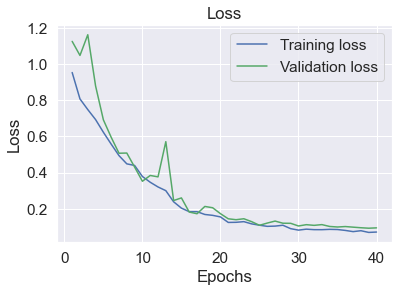

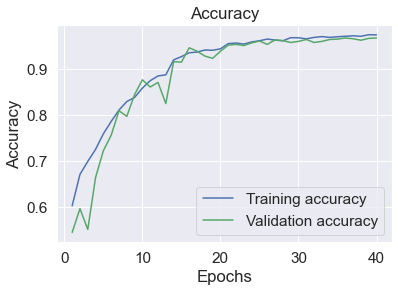

In [284]:
plot_history(vgg_FT_history,"Vgg16") 

39/39 [==============================] - 10s 264ms/step - loss: 0.0941 - accuracy: 0.9688
Validation: accuracy = 0.968827  ;  loss_v = 0.094083
Train: accuracy = 0.986528  ;  loss = 0.033165


Time taken for predicting the model: 10.84372 seconds

 Confusion Matrix 

[[234   2   0   0   0]
 [  0 234   3   0   1]
 [  3  10 236   2   6]
 [  0   0   2 227   1]
 [  0   0   2   6 250]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       236
           1       0.95      0.98      0.97       238
           2       0.97      0.92      0.94       257
           3       0.97      0.99      0.98       230
           4       0.97      0.97      0.97       258

   micro avg       0.97      0.97      0.97      1219
   macro avg       0.97      0.97      0.97      1219
weighted avg       0.97      0.97      0.97      1219
 samples avg       0.97      0.97      0.97      1219



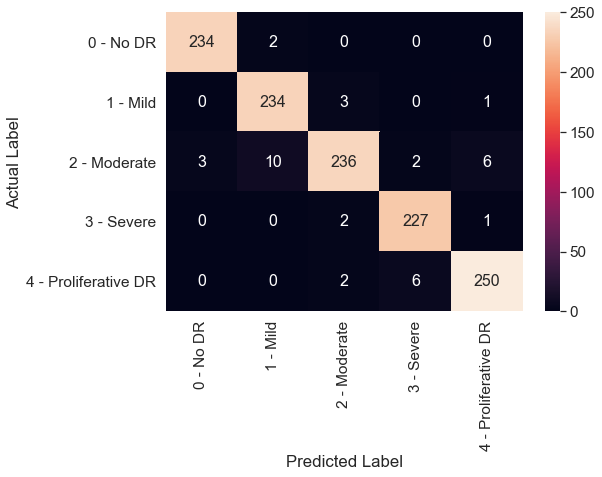

Accuracy: 0.9688269073010665
precision: 0.9689662204390276
recall: 0.9688269073010665
fscore: 0.9686666584103092
QWK Score: 0.9838879711987509



 Predicting labels using validation dataset




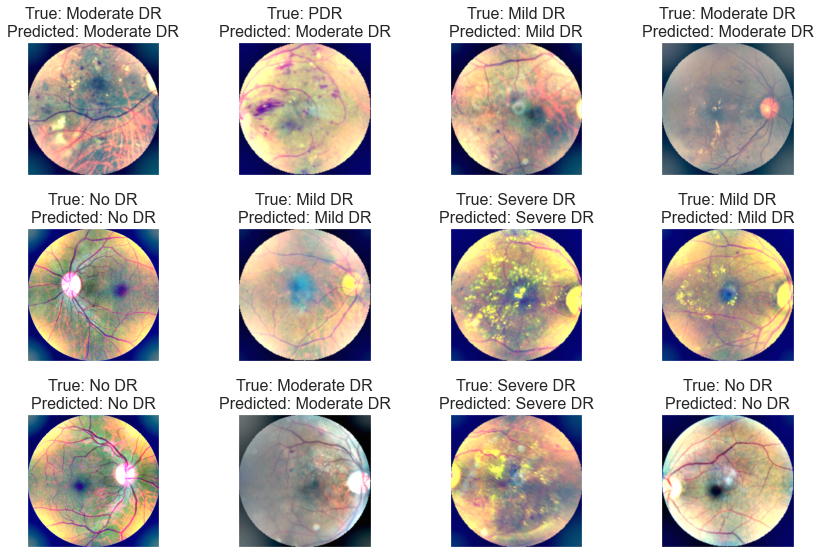

In [75]:
performace_evaluate(vgg_FT)

##  Make prediction on Unseen Test Dataset



Time taken for predicting the model: 7.21283 seconds

 Confusion Matrix 

[[192   2   1   0   0]
 [  1 167   4   0   2]
 [  0  10 151   2   6]
 [  0   0   1 171   2]
 [  0   0   2   3 186]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.99      0.98      0.99       195
           1       0.93      0.96      0.95       174
           2       0.95      0.89      0.92       169
           3       0.97      0.98      0.98       174
           4       0.95      0.97      0.96       191

   micro avg       0.96      0.96      0.96       903
   macro avg       0.96      0.96      0.96       903
weighted avg       0.96      0.96      0.96       903
 samples avg       0.96      0.96      0.96       903



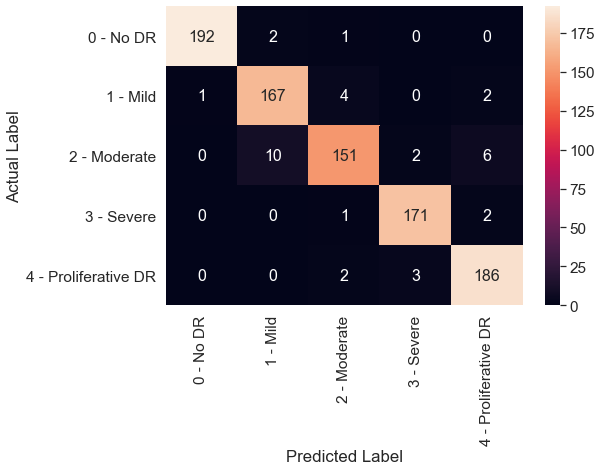

Accuracy: 0.9601328903654485
precision: 0.960280850946813
recall: 0.9601328903654485
fscore: 0.9599641932806355
QWK Score: 0.979227216460983



 Predicting labels using validation dataset




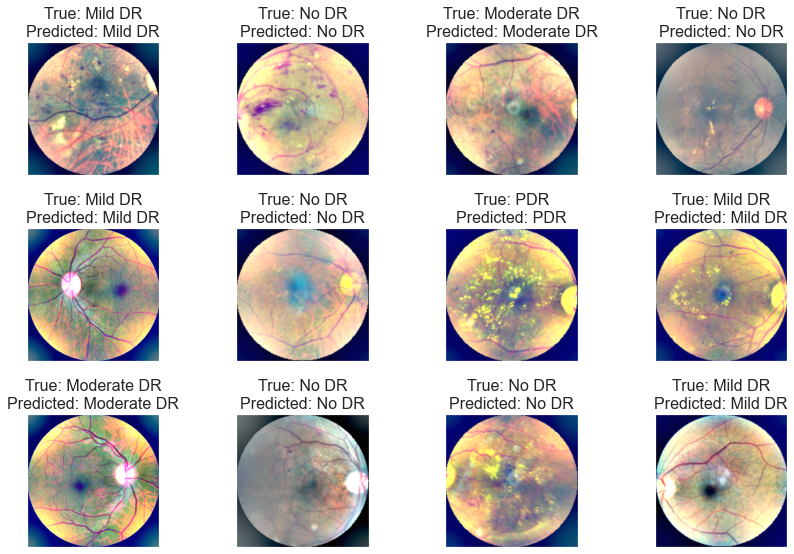

In [77]:
test_prediction(vgg_FT)

##  Make prediction on Test Dataset


61/61 [==============================] - 16s 266ms/step

 Distribution of predicted label 



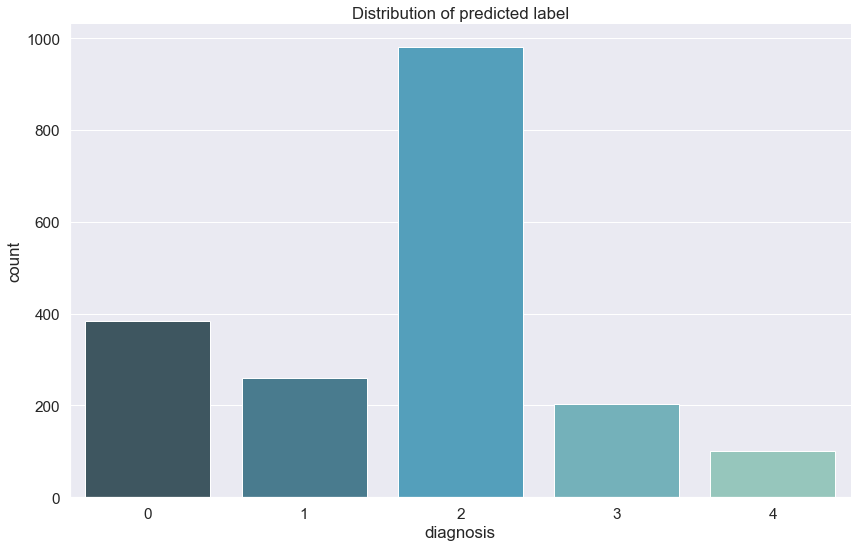




 Predicting labels using Test dataset




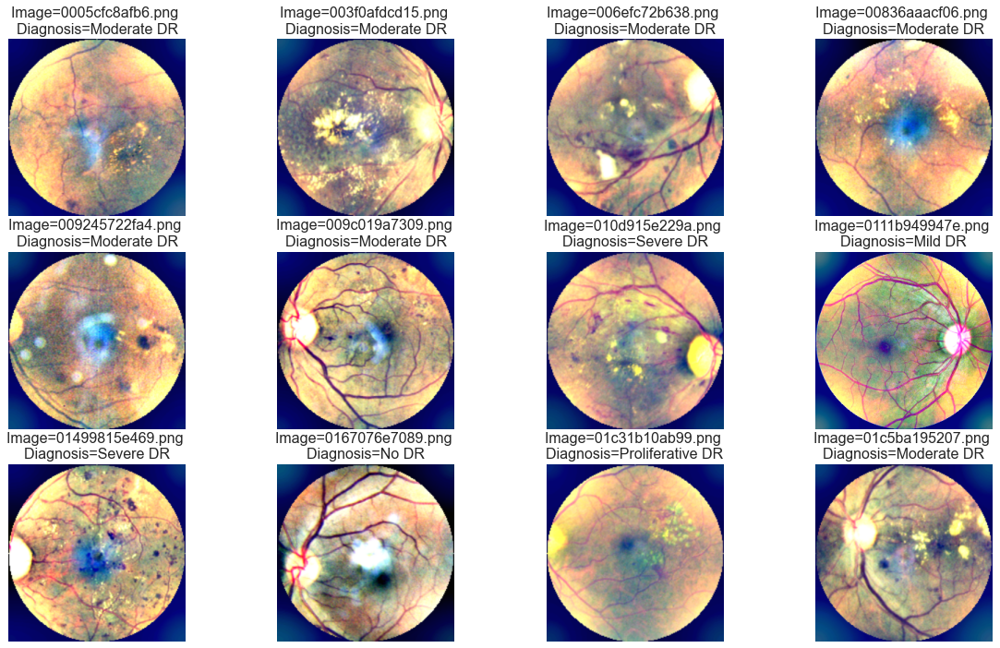

In [91]:
predict_labels(vgg_FT)

## ResNet50

In [221]:
resnet_model,resnet_history= Initial_Training_1(resnet,"resnet_1")

input_2
conv1_pad
conv1_conv
conv1_bn
conv1_relu
pool1_pad
pool1_pool
conv2_block1_1_conv
conv2_block1_1_bn
conv2_block1_1_relu
conv2_block1_2_conv
conv2_block1_2_bn
conv2_block1_2_relu
conv2_block1_0_conv
conv2_block1_3_conv
conv2_block1_0_bn
conv2_block1_3_bn
conv2_block1_add
conv2_block1_out
conv2_block2_1_conv
conv2_block2_1_bn
conv2_block2_1_relu
conv2_block2_2_conv
conv2_block2_2_bn
conv2_block2_2_relu
conv2_block2_3_conv
conv2_block2_3_bn
conv2_block2_add
conv2_block2_out
conv2_block3_1_conv
conv2_block3_1_bn
conv2_block3_1_relu
conv2_block3_2_conv
conv2_block3_2_bn
conv2_block3_2_relu
conv2_block3_3_conv
conv2_block3_3_bn
conv2_block3_add
conv2_block3_out
conv3_block1_1_conv
conv3_block1_1_bn
conv3_block1_1_relu
conv3_block1_2_conv
conv3_block1_2_bn
conv3_block1_2_relu
conv3_block1_0_conv
conv3_block1_3_conv
conv3_block1_0_bn
conv3_block1_3_bn
conv3_block1_add
conv3_block1_out
conv3_block2_1_conv
conv3_block2_1_bn
conv3_block2_1_relu
conv3_block2_2_conv
conv3_block2_2_bn
conv3_

In [222]:
resnet_FT,resnet_FT_history=model_finetuning(resnet_model,32,140,'resnet.h5')
resnet_FT.save('resnet_Full.h5')

Epoch 1/40
215/215 [==============================] - ETA: 0s - loss: 0.9236 - accuracy: 0.6190
Epoch 00001: val_loss improved from inf to 0.76034, saving model to Models/resnet.h5
215/215 [==============================] - 82s 381ms/step - loss: 0.9236 - accuracy: 0.6190 - val_loss: 0.7603 - val_accuracy: 0.6900 - lr: 1.0000e-04
Epoch 2/40
215/215 [==============================] - ETA: 0s - loss: 0.7833 - accuracy: 0.6888
Epoch 00002: val_loss improved from 0.76034 to 0.64851, saving model to Models/resnet.h5
215/215 [==============================] - 81s 378ms/step - loss: 0.7833 - accuracy: 0.6888 - val_loss: 0.6485 - val_accuracy: 0.7541 - lr: 1.0000e-04
Epoch 3/40
215/215 [==============================] - ETA: 0s - loss: 0.6568 - accuracy: 0.7441
Epoch 00003: val_loss improved from 0.64851 to 0.52973, saving model to Models/resnet.h5
215/215 [==============================] - 80s 374ms/step - loss: 0.6568 - accuracy: 0.7441 - val_loss: 0.5297 - val_accuracy: 0.7952 - lr: 1.0000e

In [280]:
resnet_FT.summary()

Model: "resnet_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 262, 262, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 128, 128, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 128, 128, 64) 256         conv1_conv[0][0]                 
___________________________________________________________________________________________

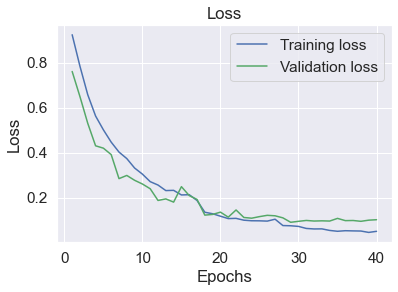

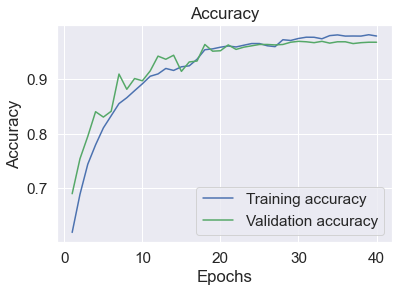

In [285]:
plot_history(resnet_FT_history,"resnet")

39/39 [==============================] - 8s 204ms/step - loss: 0.1016 - accuracy: 0.9680
Validation: accuracy = 0.968007  ;  loss_v = 0.101573
Train: accuracy = 0.987831  ;  loss = 0.026629


Time taken for predicting the model: 8.93802 seconds

 Confusion Matrix 

[[234   2   0   0   0]
 [  0 234   3   0   1]
 [  0  10 237   5   5]
 [  0   0   1 227   2]
 [  0   0   0  10 248]]

 Classification Report 

              precision    recall  f1-score   support

           0       1.00      0.99      1.00       236
           1       0.95      0.98      0.97       238
           2       0.98      0.92      0.95       257
           3       0.94      0.99      0.96       230
           4       0.97      0.96      0.96       258

   micro avg       0.97      0.97      0.97      1219
   macro avg       0.97      0.97      0.97      1219
weighted avg       0.97      0.97      0.97      1219
 samples avg       0.97      0.97      0.97      1219



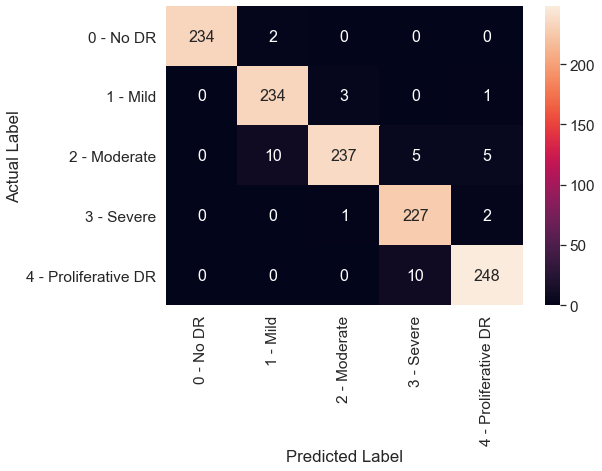

Accuracy: 0.9680065627563577
precision: 0.9686677484736312
recall: 0.9680065627563577
fscore: 0.9679542477614472
QWK Score: 0.987320123184958



 Predicting labels using validation dataset




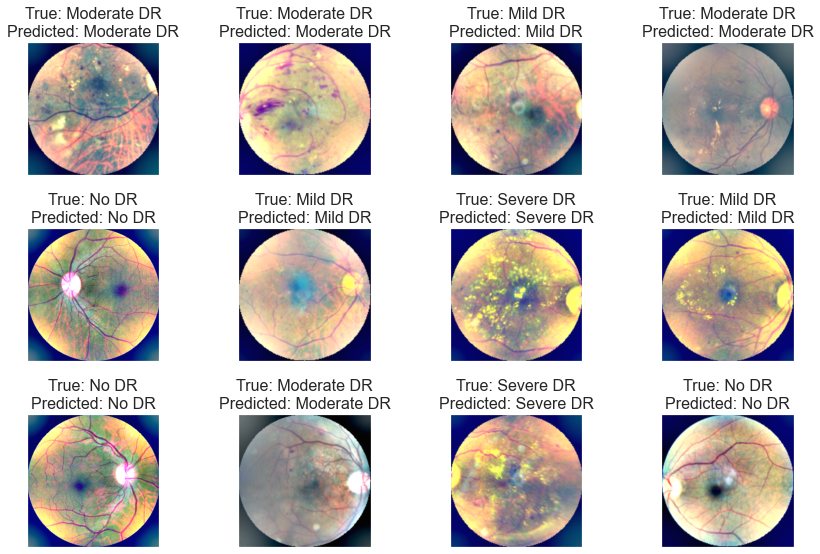

In [92]:
performace_evaluate(resnet_FT)

##  Evaluate Performance on Unseen Test Dataset



Time taken for predicting the model: 5.72925 seconds

 Confusion Matrix 

[[194   0   1   0   0]
 [  1 165   6   0   2]
 [  0   7 151   2   9]
 [  0   0   1 170   3]
 [  0   0   0   5 186]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       195
           1       0.96      0.95      0.95       174
           2       0.95      0.89      0.92       169
           3       0.96      0.98      0.97       174
           4       0.93      0.97      0.95       191

   micro avg       0.96      0.96      0.96       903
   macro avg       0.96      0.96      0.96       903
weighted avg       0.96      0.96      0.96       903
 samples avg       0.96      0.96      0.96       903



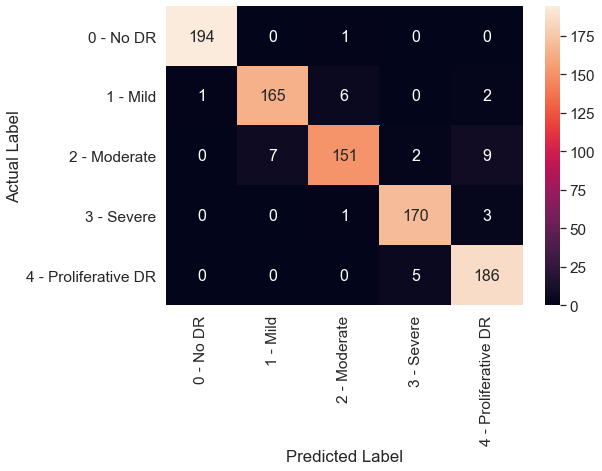

Accuracy: 0.9590254706533776
precision: 0.9592072027296471
recall: 0.9590254706533776
fscore: 0.9588295618889853
QWK Score: 0.9782794485485581



 Predicting labels using validation dataset




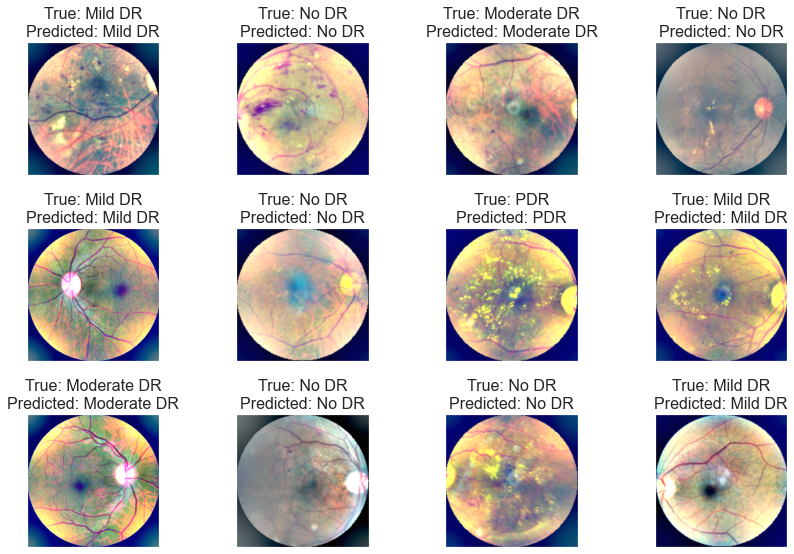

In [93]:
test_prediction(resnet_FT)

##  Evaluate Performance on Unseen Test Dataset

61/61 [==============================] - 12s 195ms/step

 Distribution of predicted label 



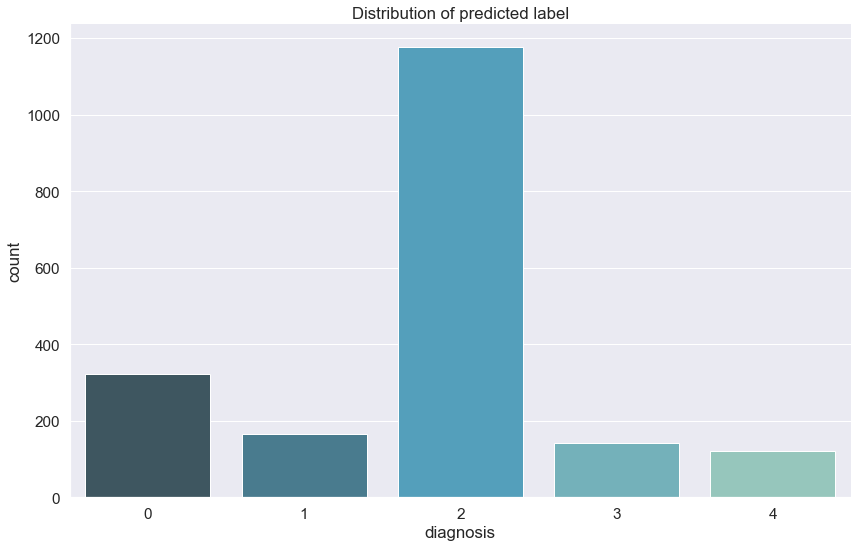




 Predicting labels using Test dataset




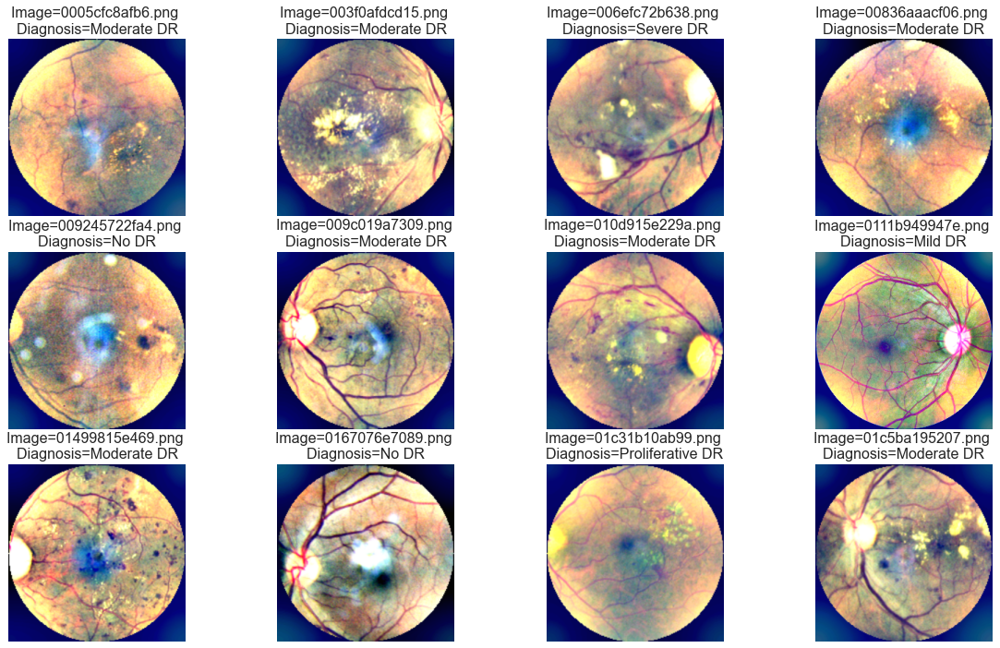

In [94]:
predict_labels(resnet_FT)

In [227]:
#gc.collect()
reset_keras()

86188


# DenseNet201

In [228]:
densenet_model,densenet_history= Initial_Training_1(densenet,"densenet_1")

input_3
zero_padding2d
conv1/conv
conv1/bn
conv1/relu
zero_padding2d_1
pool1
conv2_block1_0_bn
conv2_block1_0_relu
conv2_block1_1_conv
conv2_block1_1_bn
conv2_block1_1_relu
conv2_block1_2_conv
conv2_block1_concat
conv2_block2_0_bn
conv2_block2_0_relu
conv2_block2_1_conv
conv2_block2_1_bn
conv2_block2_1_relu
conv2_block2_2_conv
conv2_block2_concat
conv2_block3_0_bn
conv2_block3_0_relu
conv2_block3_1_conv
conv2_block3_1_bn
conv2_block3_1_relu
conv2_block3_2_conv
conv2_block3_concat
conv2_block4_0_bn
conv2_block4_0_relu
conv2_block4_1_conv
conv2_block4_1_bn
conv2_block4_1_relu
conv2_block4_2_conv
conv2_block4_concat
conv2_block5_0_bn
conv2_block5_0_relu
conv2_block5_1_conv
conv2_block5_1_bn
conv2_block5_1_relu
conv2_block5_2_conv
conv2_block5_concat
conv2_block6_0_bn
conv2_block6_0_relu
conv2_block6_1_conv
conv2_block6_1_bn
conv2_block6_1_relu
conv2_block6_2_conv
conv2_block6_concat
pool2_bn
pool2_relu
pool2_conv
pool2_pool
conv3_block1_0_bn
conv3_block1_0_relu
conv3_block1_1_conv
conv3_b

In [229]:
densenet_FT,densenet_FT_history=model_finetuning(densenet_model,32,481,'densenet.h5')
densenet_FT.save('densenet_Full.h5')

Epoch 1/40
215/215 [==============================] - ETA: 0s - loss: 1.2011 - accuracy: 0.4925
Epoch 00001: val_loss improved from inf to 1.08377, saving model to Models/densenet.h5
215/215 [==============================] - 92s 430ms/step - loss: 1.2011 - accuracy: 0.4925 - val_loss: 1.0838 - val_accuracy: 0.5510 - lr: 1.0000e-04
Epoch 2/40
215/215 [==============================] - ETA: 0s - loss: 1.0393 - accuracy: 0.5720
Epoch 00002: val_loss improved from 1.08377 to 0.96396, saving model to Models/densenet.h5
215/215 [==============================] - 88s 411ms/step - loss: 1.0393 - accuracy: 0.5720 - val_loss: 0.9640 - val_accuracy: 0.6316 - lr: 1.0000e-04
Epoch 3/40
215/215 [==============================] - ETA: 0s - loss: 0.9590 - accuracy: 0.6043
Epoch 00003: val_loss did not improve from 0.96396
215/215 [==============================] - 89s 412ms/step - loss: 0.9590 - accuracy: 0.6043 - val_loss: 1.0510 - val_accuracy: 0.5954 - lr: 1.0000e-04
Epoch 4/40
215/215 [==========

In [286]:
densenet_FT.summary()

Model: "densenet_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
zero_padding2d (ZeroPadding2D)  (None, 262, 262, 3)  0           input_3[0][0]                    
__________________________________________________________________________________________________
conv1/conv (Conv2D)             (None, 128, 128, 64) 9408        zero_padding2d[0][0]             
__________________________________________________________________________________________________
conv1/bn (BatchNormalization)   (None, 128, 128, 64) 256         conv1/conv[0][0]                 
_________________________________________________________________________________________

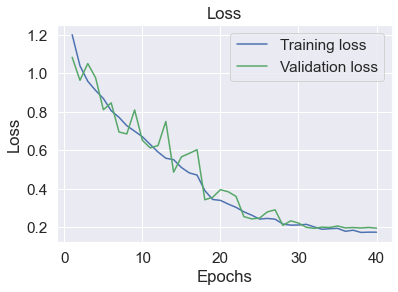

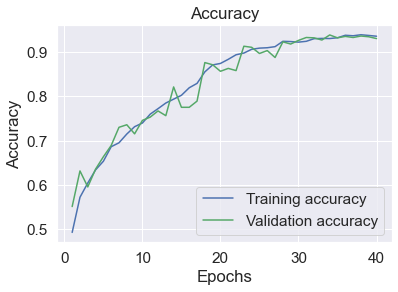

In [287]:
plot_history(densenet_FT_history,"densenet")

In [ ]:
# plot_history(densenet_FT_history,,"densenet")

39/39 [==============================] - 10s 259ms/step - loss: 0.1942 - accuracy: 0.9311
Validation: accuracy = 0.931091  ;  loss_v = 0.194199
Train: accuracy = 0.965088  ;  loss = 0.102556


Time taken for predicting the model: 12.57975 seconds

 Confusion Matrix 

[[230   5   1   0   0]
 [  6 228   3   0   1]
 [  5  23 218   3   8]
 [  0   0   6 223   1]
 [  0   2  11   9 236]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.95      0.97      0.96       236
           1       0.90      0.96      0.93       238
           2       0.93      0.84      0.88       257
           3       0.95      0.96      0.96       230
           4       0.96      0.91      0.94       258

   micro avg       0.94      0.93      0.93      1219
   macro avg       0.94      0.93      0.93      1219
weighted avg       0.94      0.93      0.93      1219
 samples avg       0.93      0.93      0.93      1219



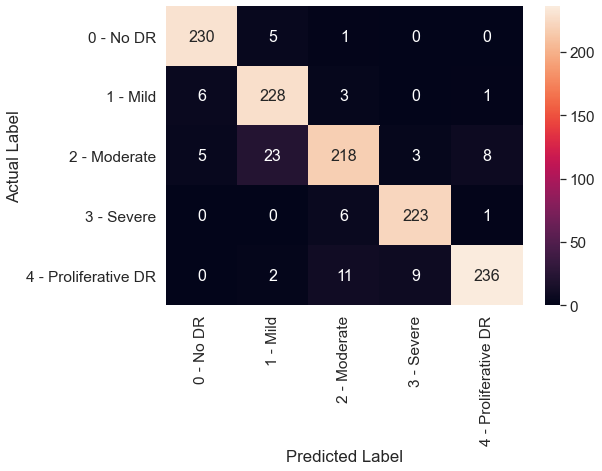

Accuracy: 0.9310910582444627
precision: 0.9316978847216671
recall: 0.9310910582444627
fscore: 0.9307038873048898
QWK Score: 0.9625442702356093



 Predicting labels using validation dataset




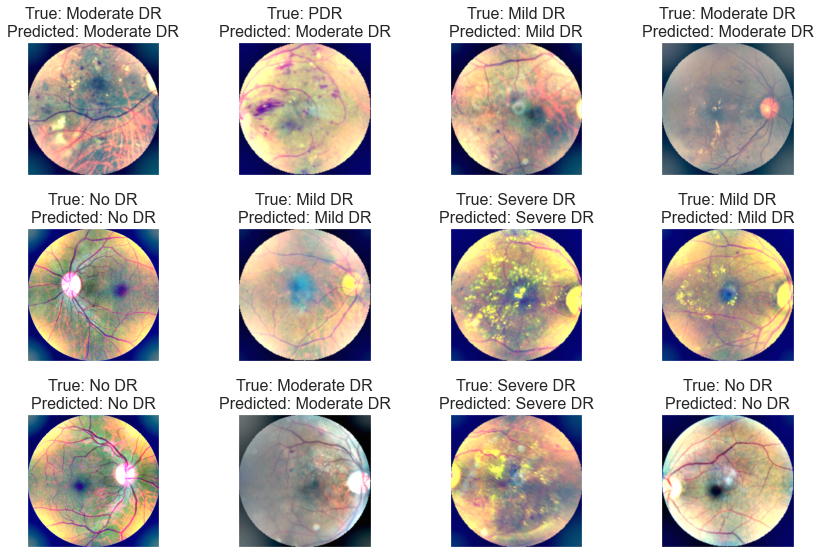

In [95]:
performace_evaluate(densenet_FT)

##  Evaluate Performance on Unseen Test Dataset





Time taken for predicting the model: 7.39936 seconds

 Confusion Matrix 

[[184  11   0   0   0]
 [  2 165   5   0   2]
 [  2  21 139   1   6]
 [  0   0   5 167   2]
 [  0   5   5   4 177]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.98      0.94      0.96       195
           1       0.83      0.95      0.89       174
           2       0.92      0.82      0.87       169
           3       0.98      0.95      0.97       174
           4       0.95      0.93      0.94       191

   micro avg       0.93      0.92      0.92       903
   macro avg       0.93      0.92      0.92       903
weighted avg       0.93      0.92      0.92       903
 samples avg       0.92      0.92      0.92       903



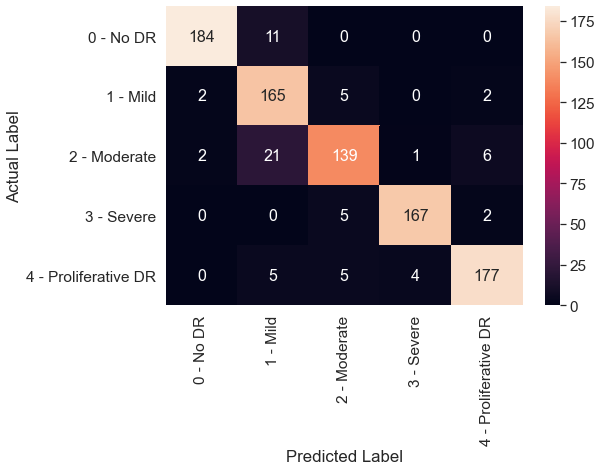

Accuracy: 0.9213732004429679
precision: 0.9249686538890766
recall: 0.9213732004429679
fscore: 0.9217819849287434
QWK Score: 0.9559147646628743



 Predicting labels using validation dataset




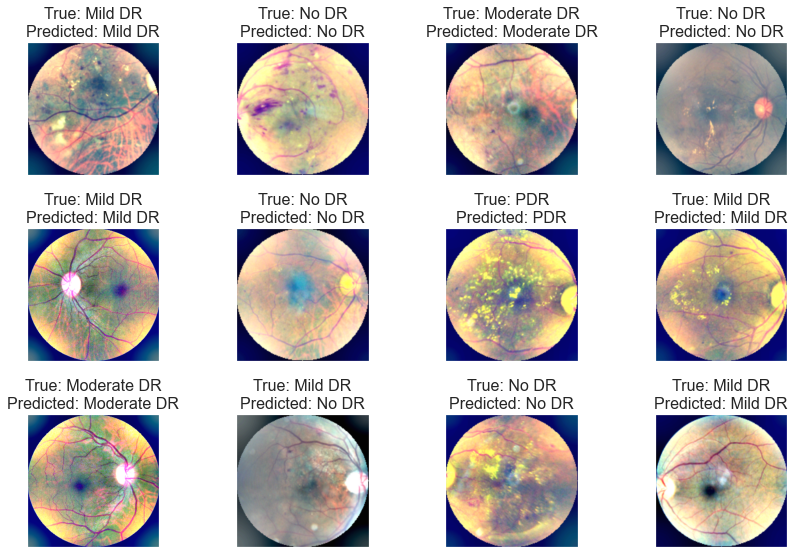

In [96]:
test_prediction(densenet_FT)

##  Make prediction on Test Dataset


61/61 [==============================] - 16s 259ms/step

 Distribution of predicted label 



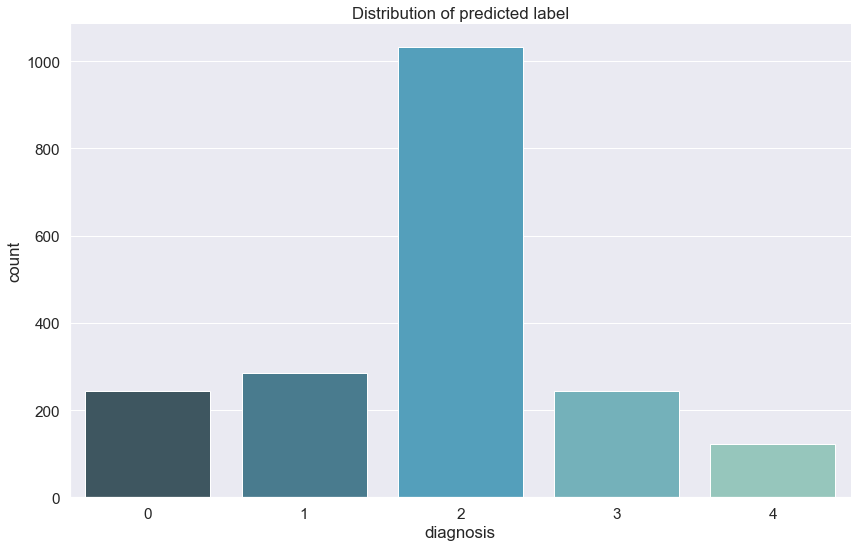




 Predicting labels using Test dataset




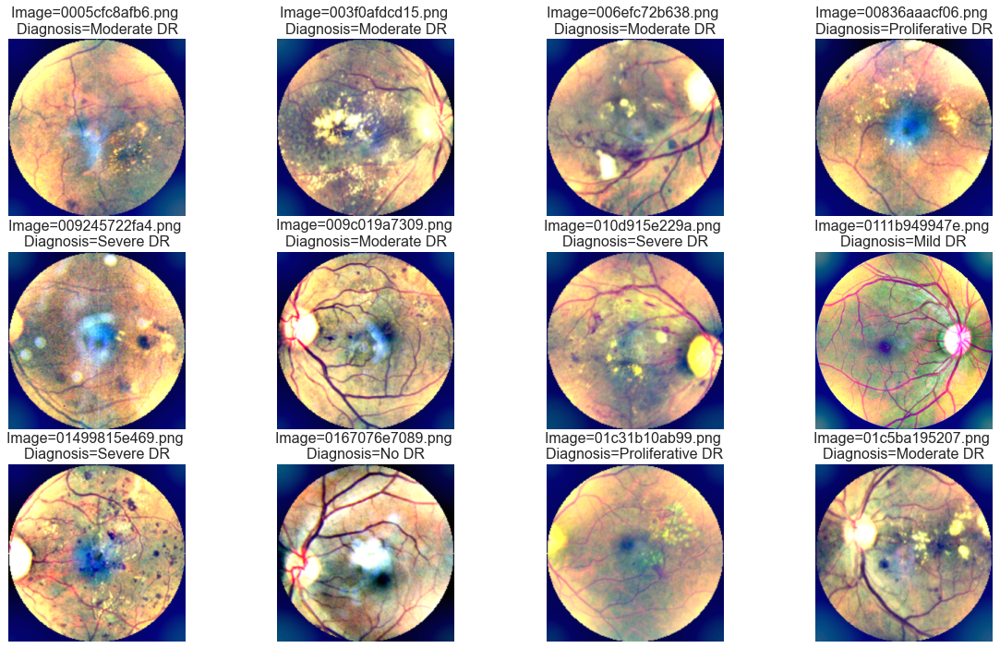

In [97]:

predict_labels(densenet_FT)

# InceptionV3

In [22]:

inceptnet_model,incept_history= Initial_Training_2(inceptnet,"incept_1")

input_4
conv2d
batch_normalization
activation
conv2d_1
batch_normalization_1
activation_1
conv2d_2
batch_normalization_2
activation_2
max_pooling2d
conv2d_3
batch_normalization_3
activation_3
conv2d_4
batch_normalization_4
activation_4
max_pooling2d_1
conv2d_8
batch_normalization_8
activation_8
conv2d_6
conv2d_9
batch_normalization_6
batch_normalization_9
activation_6
activation_9
average_pooling2d
conv2d_5
conv2d_7
conv2d_10
conv2d_11
batch_normalization_5
batch_normalization_7
batch_normalization_10
batch_normalization_11
activation_5
activation_7
activation_10
activation_11
mixed0
conv2d_15
batch_normalization_15
activation_15
conv2d_13
conv2d_16
batch_normalization_13
batch_normalization_16
activation_13
activation_16
average_pooling2d_1
conv2d_12
conv2d_14
conv2d_17
conv2d_18
batch_normalization_12
batch_normalization_14
batch_normalization_17
batch_normalization_18
activation_12
activation_14
activation_17
activation_18
mixed1
conv2d_22
batch_normalization_22
activation_22
conv2d

In [23]:
incept_FT,incept_FT_history=model_finetuning(inceptnet_model,32,249,'incept.h5')
incept_FT.save('incept_Full.h5')

Epoch 1/40
215/215 [==============================] - ETA: 0s - loss: 1.1062 - accuracy: 0.5346
Epoch 00001: val_loss improved from inf to 0.94389, saving model to Models/incept.h5
215/215 [==============================] - 78s 361ms/step - loss: 1.1062 - accuracy: 0.5346 - val_loss: 0.9439 - val_accuracy: 0.5970 - lr: 1.0000e-04
Epoch 2/40
215/215 [==============================] - ETA: 0s - loss: 0.9534 - accuracy: 0.6041
Epoch 00002: val_loss improved from 0.94389 to 0.86669, saving model to Models/incept.h5
215/215 [==============================] - 76s 355ms/step - loss: 0.9534 - accuracy: 0.6041 - val_loss: 0.8667 - val_accuracy: 0.6447 - lr: 1.0000e-04
Epoch 3/40
215/215 [==============================] - ETA: 0s - loss: 0.8794 - accuracy: 0.6394
Epoch 00003: val_loss improved from 0.86669 to 0.74308, saving model to Models/incept.h5
215/215 [==============================] - 76s 355ms/step - loss: 0.8794 - accuracy: 0.6394 - val_loss: 0.7431 - val_accuracy: 0.6998 - lr: 1.0000e

In [24]:
incept_FT.summary()

Model: "incept_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 127, 127, 32) 864         input_4[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 127, 127, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 127, 127, 32) 0           batch_normalization[0][0]        
___________________________________________________________________________________________

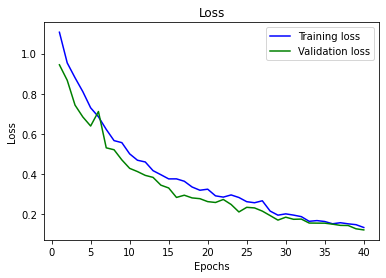

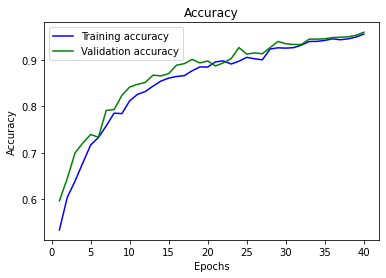

In [25]:
plot_history(incept_FT_history,"InceptionV3") 

In [26]:
# plot_history(incept_FT_history) 

39/39 [==============================] - 5s 127ms/step - loss: 0.1211 - accuracy: 0.9590
Validation: accuracy = 0.958983  ;  loss_v = 0.121089
Train: accuracy = 0.976677  ;  loss = 0.060780


Time taken for predicting the model: 6.05649 seconds

 Confusion Matrix 

[[235   0   1   0   0]
 [  0 230   7   0   1]
 [  5   5 234   6   7]
 [  0   0   1 228   1]
 [  0   1   4  11 242]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.98      1.00      0.99       236
           1       0.97      0.96      0.97       238
           2       0.95      0.89      0.92       257
           3       0.93      0.99      0.96       230
           4       0.97      0.93      0.95       258

   micro avg       0.96      0.95      0.96      1219
   macro avg       0.96      0.95      0.96      1219
weighted avg       0.96      0.95      0.96      1219
 samples avg       0.95      0.95      0.95      1219



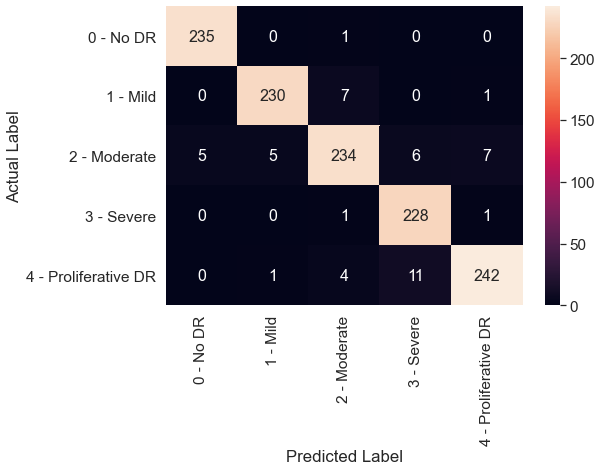

Accuracy: 0.9589827727645611
precision: 0.9592255868718843
recall: 0.9589827727645611
fscore: 0.9587913254015304
QWK Score: 0.9760597597062775



 Predicting labels using validation dataset




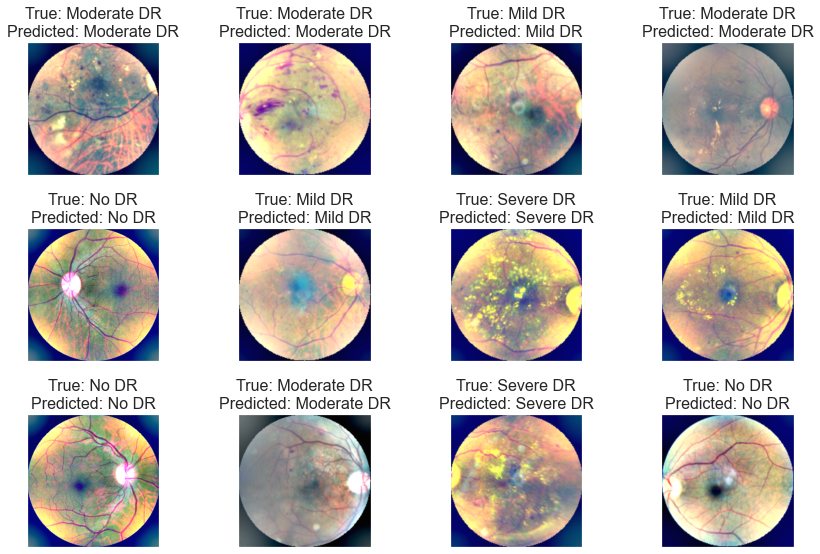

In [98]:
performace_evaluate(incept_FT)

##  Evaluate Performance on Unseen Test Dataset




Time taken for predicting the model: 3.70302 seconds

 Confusion Matrix 

[[192   2   1   0   0]
 [  1 165   6   0   2]
 [  7   6 145   2   9]
 [  0   0   1 172   1]
 [  0   2   3   6 180]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.96      0.98      0.97       195
           1       0.96      0.95      0.95       174
           2       0.93      0.85      0.89       169
           3       0.96      0.99      0.97       174
           4       0.94      0.94      0.94       191

   micro avg       0.95      0.94      0.95       903
   macro avg       0.95      0.94      0.95       903
weighted avg       0.95      0.94      0.95       903
 samples avg       0.94      0.94      0.94       903



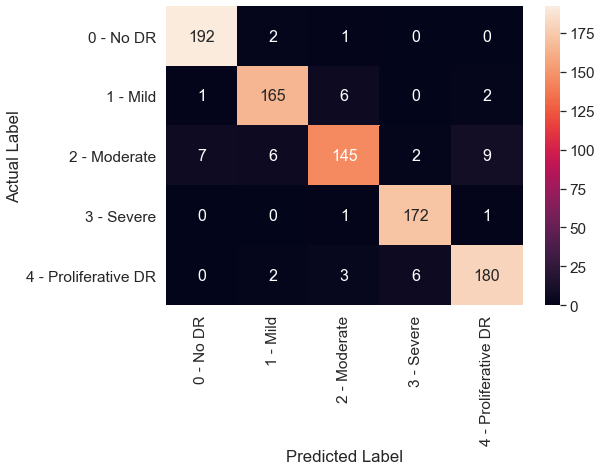

Accuracy: 0.9457364341085271
precision: 0.9453705900965037
recall: 0.9457364341085271
fscore: 0.9451955844472973
QWK Score: 0.9630387407689747



 Predicting labels using validation dataset




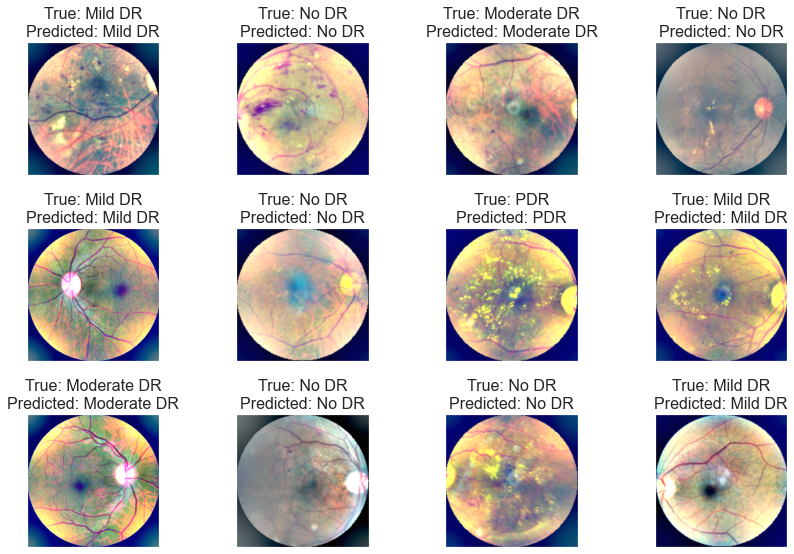

In [99]:
test_prediction(incept_FT)

##  Make prediction on Test Dataset

61/61 [==============================] - 8s 124ms/step

 Distribution of predicted label 



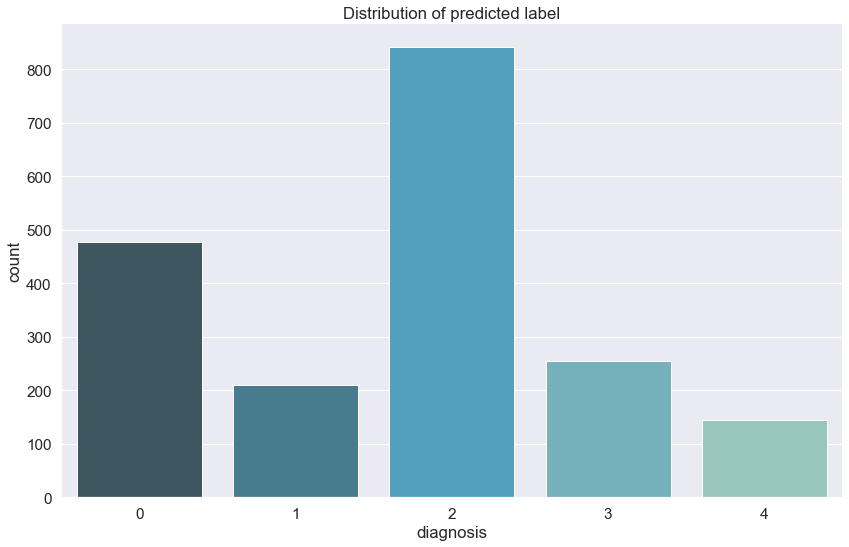




 Predicting labels using Test dataset




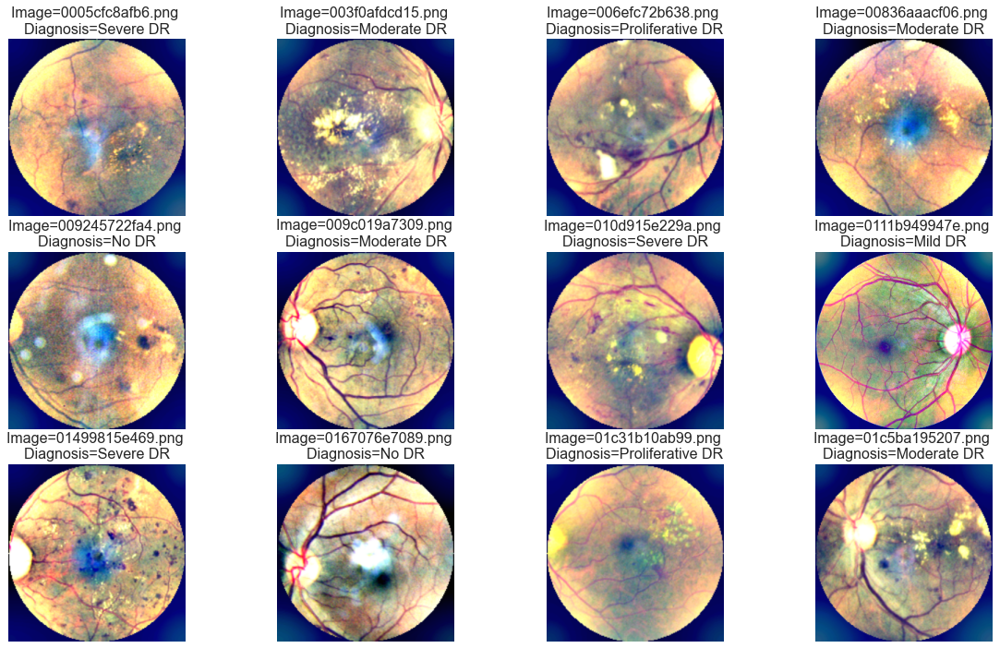

In [100]:
predict_labels(incept_FT)

# InceptionResNetV2

In [30]:
incept_resnet_model, incept_resnet_history= Initial_Training_2(incept_resnet,"incept_res_1")

input_5
conv2d_94
batch_normalization_94
activation_94
conv2d_95
batch_normalization_95
activation_95
conv2d_96
batch_normalization_96
activation_96
max_pooling2d_4
conv2d_97
batch_normalization_97
activation_97
conv2d_98
batch_normalization_98
activation_98
max_pooling2d_5
conv2d_102
batch_normalization_102
activation_102
conv2d_100
conv2d_103
batch_normalization_100
batch_normalization_103
activation_100
activation_103
average_pooling2d_9
conv2d_99
conv2d_101
conv2d_104
conv2d_105
batch_normalization_99
batch_normalization_101
batch_normalization_104
batch_normalization_105
activation_99
activation_101
activation_104
activation_105
mixed_5b
conv2d_109
batch_normalization_109
activation_109
conv2d_107
conv2d_110
batch_normalization_107
batch_normalization_110
activation_107
activation_110
conv2d_106
conv2d_108
conv2d_111
batch_normalization_106
batch_normalization_108
batch_normalization_111
activation_106
activation_108
activation_111
block35_1_mixed
block35_1_conv
block35_1
block35_

In [31]:
incep_res_FT,incep_res_FT_history=model_finetuning(incept_resnet_model,32,618,'incep_res.h5')
incep_res_FT.save('incep_res_Full.h5')

Epoch 1/40
215/215 [==============================] - ETA: 0s - loss: 1.0361 - accuracy: 0.5721
Epoch 00001: val_loss improved from inf to 0.91572, saving model to Models/incep_res.h5
215/215 [==============================] - 100s 467ms/step - loss: 1.0361 - accuracy: 0.5721 - val_loss: 0.9157 - val_accuracy: 0.6735 - lr: 1.0000e-04
Epoch 2/40
215/215 [==============================] - ETA: 0s - loss: 0.8940 - accuracy: 0.6309
Epoch 00002: val_loss improved from 0.91572 to 0.83472, saving model to Models/incep_res.h5
215/215 [==============================] - 97s 452ms/step - loss: 0.8940 - accuracy: 0.6309 - val_loss: 0.8347 - val_accuracy: 0.6990 - lr: 1.0000e-04
Epoch 3/40
215/215 [==============================] - ETA: 0s - loss: 0.7834 - accuracy: 0.6904
Epoch 00003: val_loss improved from 0.83472 to 0.75877, saving model to Models/incep_res.h5
215/215 [==============================] - 98s 457ms/step - loss: 0.7834 - accuracy: 0.6904 - val_loss: 0.7588 - val_accuracy: 0.7081 - l

In [32]:
incep_res_FT.summary()

Model: "incept_res_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_94 (Conv2D)              (None, 127, 127, 32) 864         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_94 (BatchNo (None, 127, 127, 32) 96          conv2d_94[0][0]                  
__________________________________________________________________________________________________
activation_94 (Activation)      (None, 127, 127, 32) 0           batch_normalization_94[0][0]     
_______________________________________________________________________________________

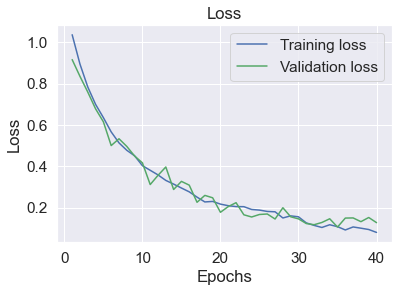

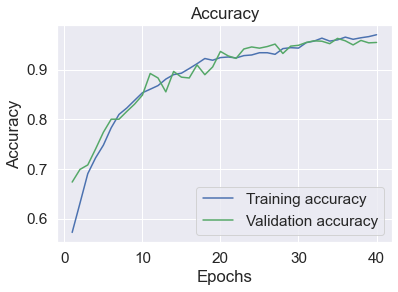

In [33]:
plot_history(incep_res_FT_history,"InceptionResNetV2") 

In [34]:
# plot_history(incep_res_FT_history) 

39/39 [==============================] - 13s 342ms/step - loss: 0.1269 - accuracy: 0.9549
Validation: accuracy = 0.954881  ;  loss_v = 0.126946
Train: accuracy = 0.983196  ;  loss = 0.041079


Time taken for predicting the model: 16.93655 seconds

 Confusion Matrix 

[[233   3   0   0   0]
 [  0 234   3   0   1]
 [  4  16 224   7   6]
 [  0   0   1 225   4]
 [  0   1   1   8 248]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.98      0.99      0.99       236
           1       0.92      0.97      0.95       238
           2       0.98      0.87      0.92       257
           3       0.94      0.98      0.96       230
           4       0.96      0.96      0.96       258

   micro avg       0.96      0.95      0.96      1219
   macro avg       0.96      0.95      0.96      1219
weighted avg       0.96      0.95      0.95      1219
 samples avg       0.95      0.95      0.95      1219



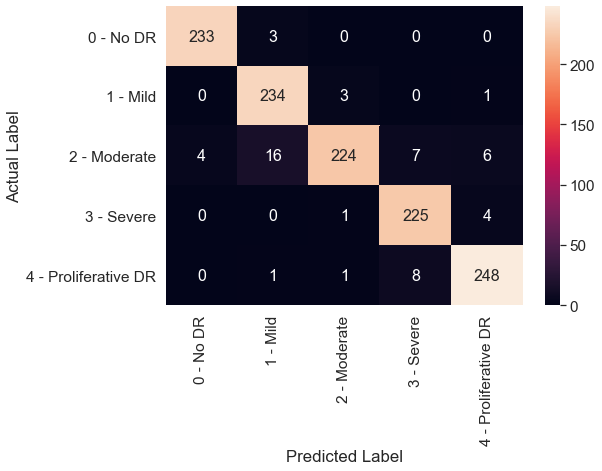

Accuracy: 0.9548810500410172
precision: 0.9559744360028684
recall: 0.9548810500410172
fscore: 0.954500466537365
QWK Score: 0.9788627683877875



 Predicting labels using validation dataset




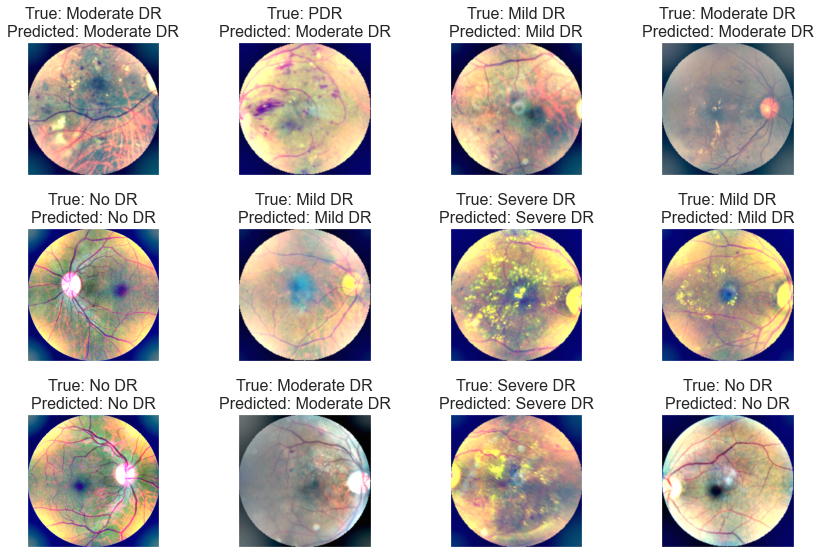

In [101]:
performace_evaluate(incep_res_FT)

##  Evaluate Performance on Unseen Test Dataset



Time taken for predicting the model: 10.03405 seconds

 Confusion Matrix 

[[191   2   2   0   0]
 [  0 169   3   0   2]
 [  0  14 148   2   5]
 [  0   0   1 168   5]
 [  0   2   2   3 184]]

 Classification Report 

              precision    recall  f1-score   support

           0       1.00      0.97      0.99       195
           1       0.90      0.97      0.93       174
           2       0.96      0.88      0.92       169
           3       0.98      0.97      0.97       174
           4       0.94      0.96      0.95       191

   micro avg       0.96      0.95      0.95       903
   macro avg       0.96      0.95      0.95       903
weighted avg       0.96      0.95      0.95       903
 samples avg       0.95      0.95      0.95       903



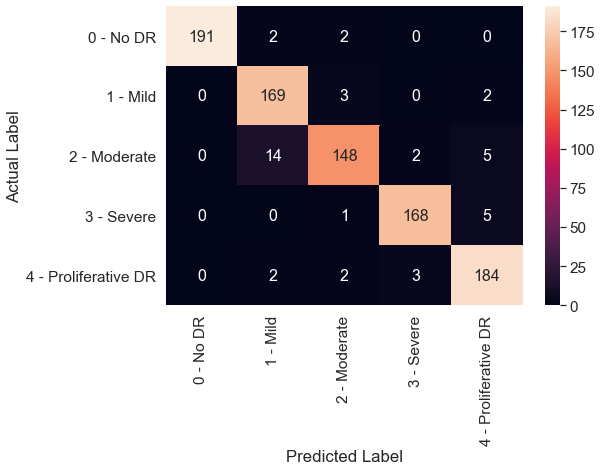

Accuracy: 0.9523809523809523
precision: 0.9533354274048778
recall: 0.9523809523809523
fscore: 0.9522926809625882
QWK Score: 0.9731573940879005



 Predicting labels using validation dataset




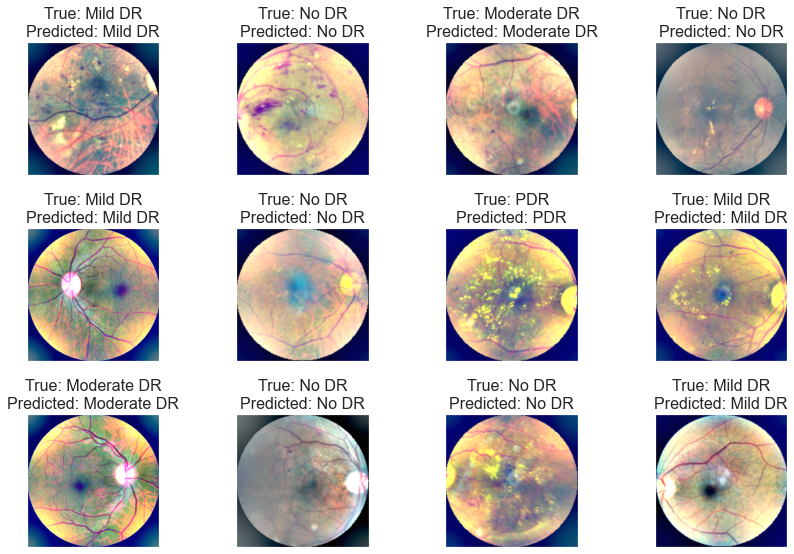

In [102]:
test_prediction(incep_res_FT)

##  Make prediction on Test Dataset

61/61 [==============================] - 21s 344ms/step

 Distribution of predicted label 



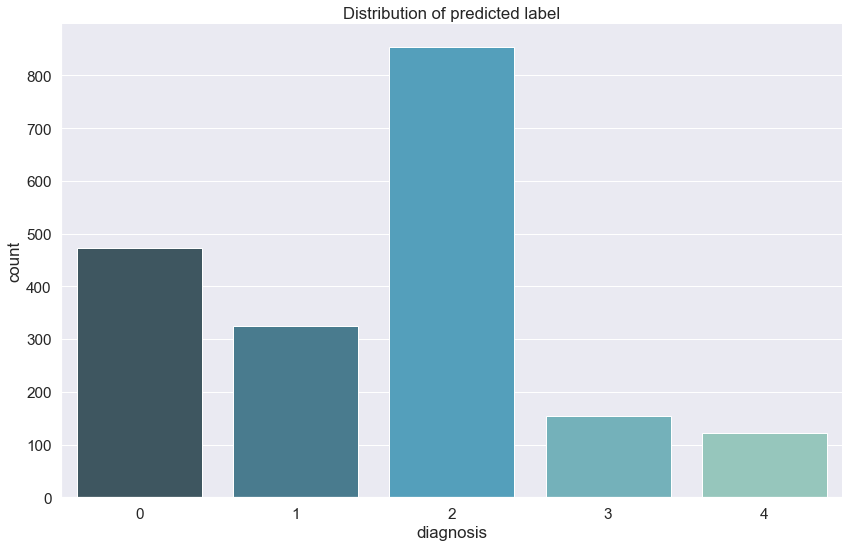




 Predicting labels using Test dataset




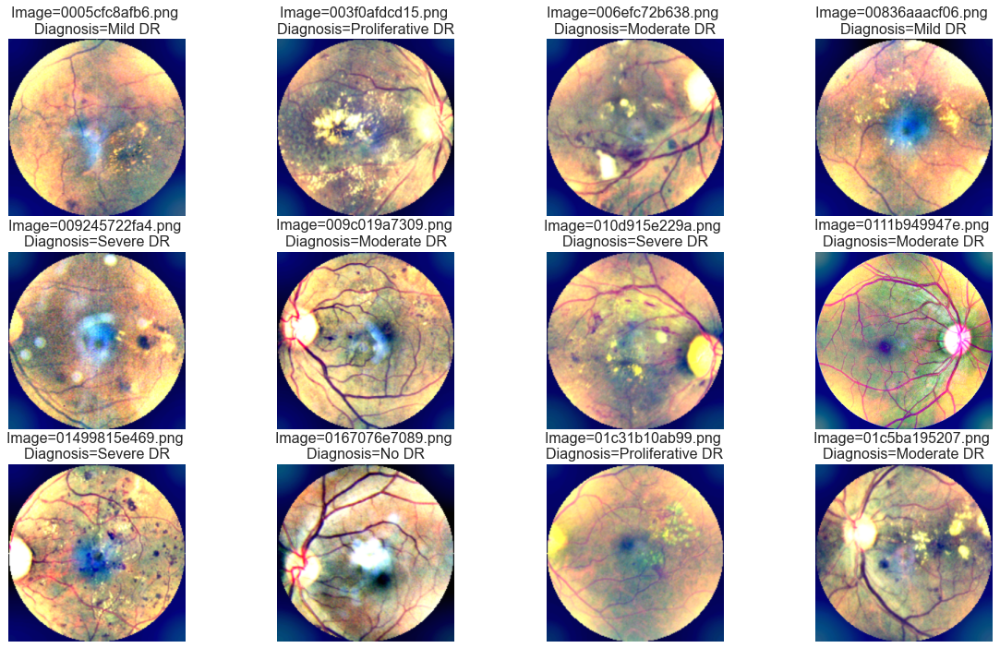

In [103]:
predict_labels(incep_res_FT)

# Xception

In [22]:
xceptnet_model,xcept_history= Initial_Training_2(xceptnet,"xcept_1")

input_6
block1_conv1
block1_conv1_bn
block1_conv1_act
block1_conv2
block1_conv2_bn
block1_conv2_act
block2_sepconv1
block2_sepconv1_bn
block2_sepconv2_act
block2_sepconv2
block2_sepconv2_bn
conv2d_297
block2_pool
batch_normalization_297
add
block3_sepconv1_act
block3_sepconv1
block3_sepconv1_bn
block3_sepconv2_act
block3_sepconv2
block3_sepconv2_bn
conv2d_298
block3_pool
batch_normalization_298
add_1
block4_sepconv1_act
block4_sepconv1
block4_sepconv1_bn
block4_sepconv2_act
block4_sepconv2
block4_sepconv2_bn
conv2d_299
block4_pool
batch_normalization_299
add_2
block5_sepconv1_act
block5_sepconv1
block5_sepconv1_bn
block5_sepconv2_act
block5_sepconv2
block5_sepconv2_bn
block5_sepconv3_act
block5_sepconv3
block5_sepconv3_bn
add_3
block6_sepconv1_act
block6_sepconv1
block6_sepconv1_bn
block6_sepconv2_act
block6_sepconv2
block6_sepconv2_bn
block6_sepconv3_act
block6_sepconv3
block6_sepconv3_bn
add_4
block7_sepconv1_act
block7_sepconv1
block7_sepconv1_bn
block7_sepconv2_act
block7_sepconv2


In [23]:
xceptnet_FT,xceptnet_FT_history=model_finetuning(xceptnet_model,32,116,'Xcept.h5')
xceptnet_FT.save('Xcept_Full.h5')

Epoch 1/40
215/215 [==============================] - ETA: 0s - loss: 1.0167 - accuracy: 0.5728
Epoch 00001: val_loss improved from inf to 0.86799, saving model to Models/Xcept.h5
215/215 [==============================] - 104s 482ms/step - loss: 1.0167 - accuracy: 0.5728 - val_loss: 0.8680 - val_accuracy: 0.6562 - lr: 1.0000e-04
Epoch 2/40
215/215 [==============================] - ETA: 0s - loss: 0.9111 - accuracy: 0.6241
Epoch 00002: val_loss improved from 0.86799 to 0.82896, saving model to Models/Xcept.h5
215/215 [==============================] - 101s 472ms/step - loss: 0.9111 - accuracy: 0.6241 - val_loss: 0.8290 - val_accuracy: 0.6612 - lr: 1.0000e-04
Epoch 3/40
215/215 [==============================] - ETA: 0s - loss: 0.8390 - accuracy: 0.6541
Epoch 00003: val_loss improved from 0.82896 to 0.78976, saving model to Models/Xcept.h5
215/215 [==============================] - 100s 465ms/step - loss: 0.8390 - accuracy: 0.6541 - val_loss: 0.7898 - val_accuracy: 0.6785 - lr: 1.0000e

In [24]:
xceptnet_FT.summary()

Model: "xcept_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 127, 127, 32) 864         input_6[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 127, 127, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 127, 127, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

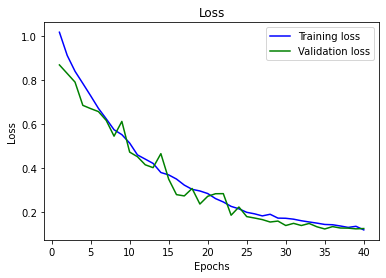

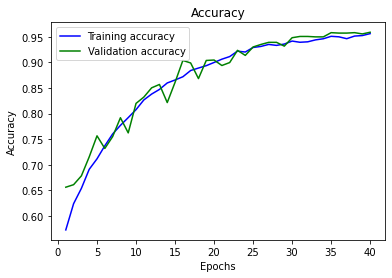

In [25]:
plot_history(xceptnet_FT_history,"Xception") 


In [26]:
#plot_history(xceptnet_FT_history) 

39/39 [==============================] - 12s 313ms/step - loss: 0.1231 - accuracy: 0.9590
Validation: accuracy = 0.958983  ;  loss_v = 0.123146
Train: accuracy = 0.976097  ;  loss = 0.070387


Time taken for predicting the model: 13.53446 seconds

 Confusion Matrix 

[[236   0   0   0   0]
 [  4 227   6   0   1]
 [  2  11 234   7   3]
 [  0   0   6 220   4]
 [  0   1   1   4 252]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.98      1.00      0.99       236
           1       0.95      0.95      0.95       238
           2       0.95      0.90      0.92       257
           3       0.96      0.95      0.95       230
           4       0.97      0.97      0.97       258

   micro avg       0.96      0.95      0.96      1219
   macro avg       0.96      0.96      0.96      1219
weighted avg       0.96      0.95      0.96      1219
 samples avg       0.95      0.95      0.95      1219



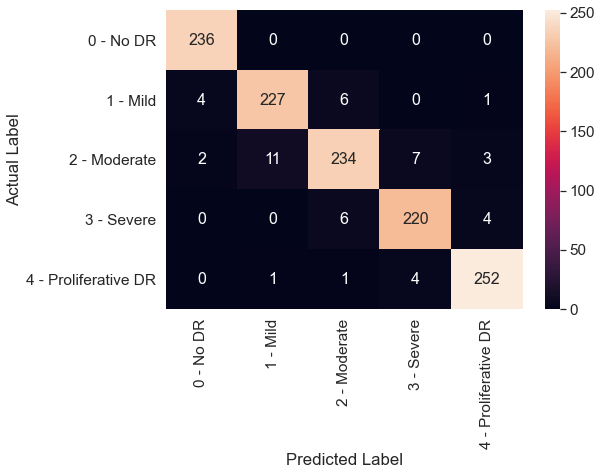

Accuracy: 0.9589827727645611
precision: 0.9588037828181158
recall: 0.9589827727645611
fscore: 0.9587813180155808
QWK Score: 0.9829280305013319



 Predicting labels using validation dataset




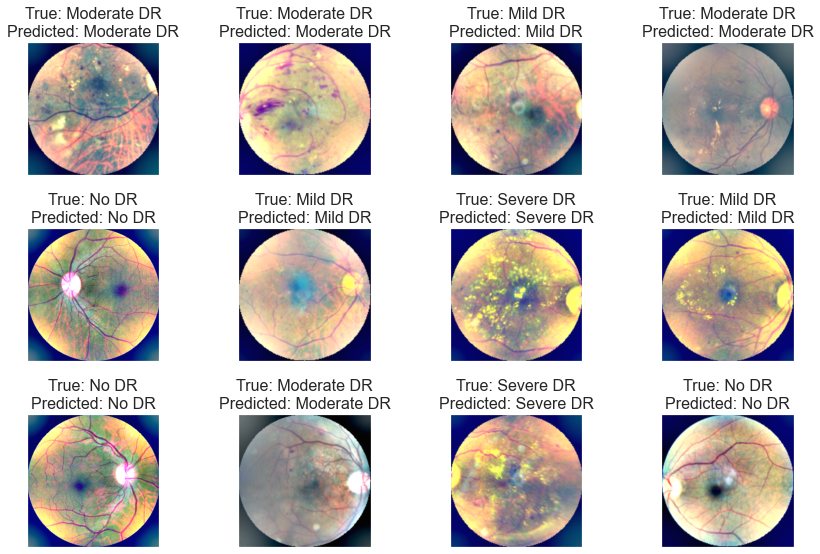

In [119]:
performace_evaluate(xceptnet_FT)

##  Evaluate Performance on Unseen Test Dataset



Time taken for predicting the model: 9.17308 seconds

 Confusion Matrix 

[[193   1   1   0   0]
 [  3 165   4   0   2]
 [  3   9 148   4   5]
 [  0   0   0 170   4]
 [  0   0   0   2 189]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.97      0.99      0.98       195
           1       0.94      0.95      0.95       174
           2       0.97      0.88      0.92       169
           3       0.97      0.97      0.97       174
           4       0.95      0.98      0.97       191

   micro avg       0.96      0.96      0.96       903
   macro avg       0.96      0.95      0.96       903
weighted avg       0.96      0.96      0.96       903
 samples avg       0.96      0.96      0.96       903



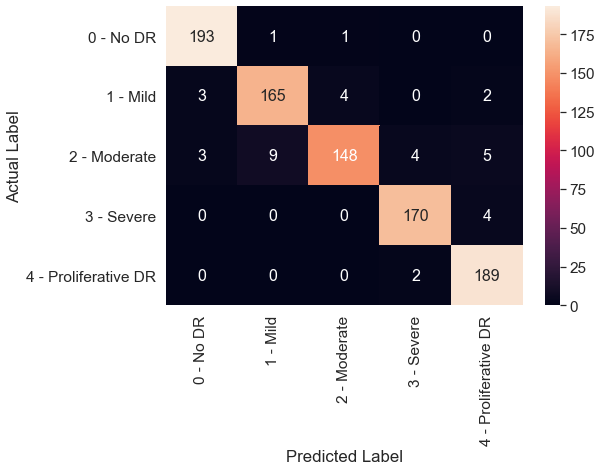

Accuracy: 0.9579180509413068
precision: 0.9581595258841712
recall: 0.9579180509413068
fscore: 0.9574751437778148
QWK Score: 0.9789010475485805



 Predicting labels using validation dataset




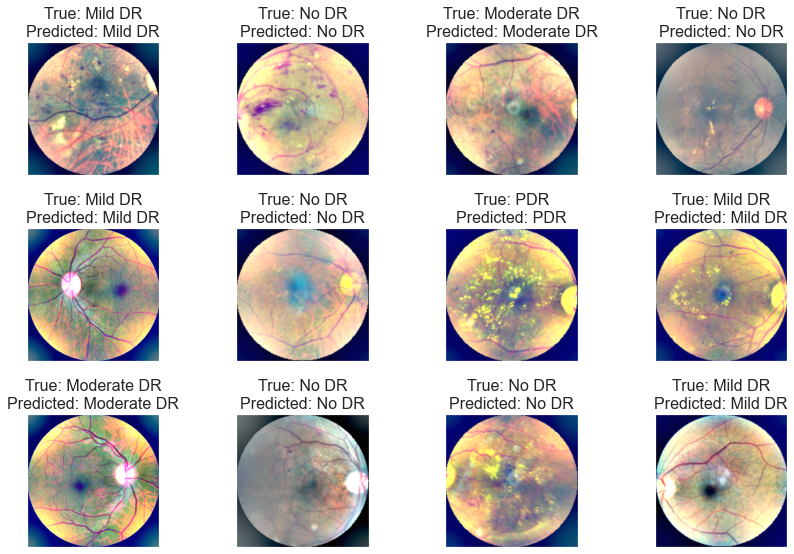

In [120]:
test_prediction(xceptnet_FT)

##  Make prediction on Test Dataset

61/61 [==============================] - 19s 315ms/step

 Distribution of predicted label 



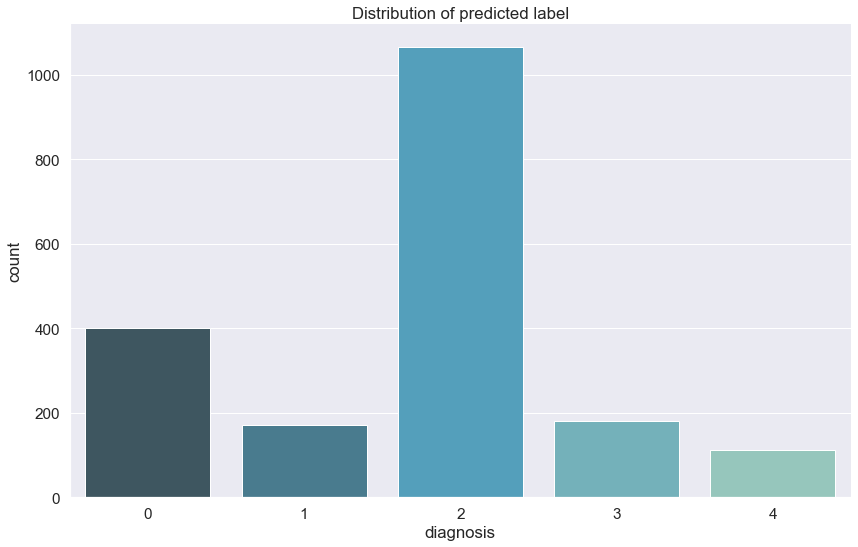




 Predicting labels using Test dataset




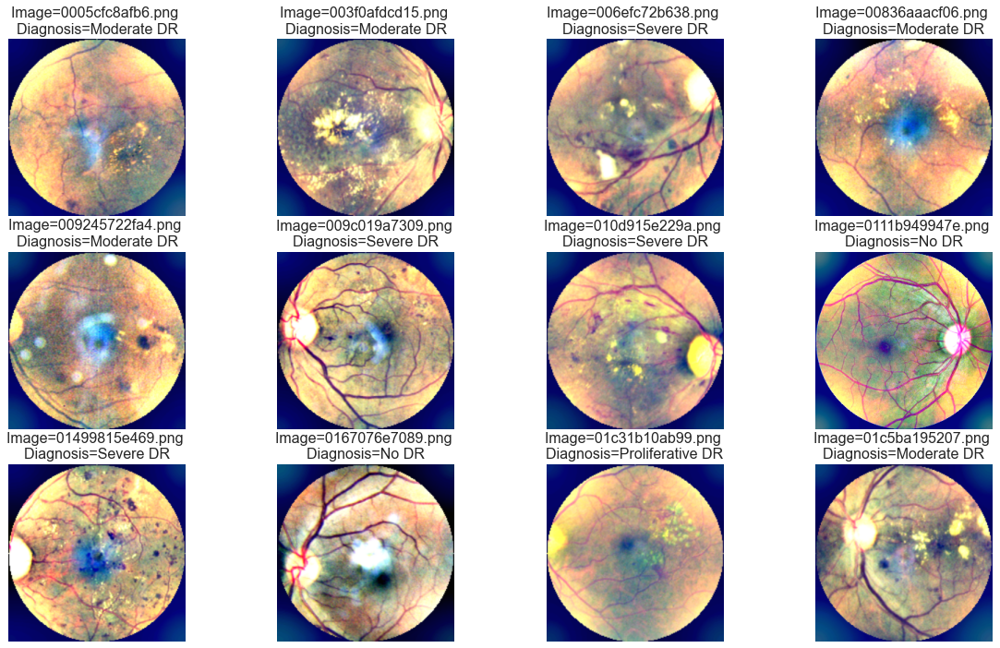

In [121]:
predict_labels(xceptnet_FT)

# Ensemble Model

In [110]:
vgg_FT=load_model('vgg16_full.h5')
resnet_FT=load_model('resnet_full.h5')
densenet_FT=load_model('densenet_full.h5')
incept_FT=load_model('incept_full.h5')
incep_res_FT=load_model('incep_res_full.h5')
xceptnet_FT=load_model('xcept_full.h5')

In [111]:
def ensembleModels(models, model_input,name):
    # collect outputs of models in a list
    yModels=[model(model_input) for model in models] 
    # averaging outputs
    yAvg=layers.average(yModels) 
    # build model from same input and avg output
    modelEns = Model(inputs=model_input, outputs=yAvg,name=name)  
   #,    name='ensemble'
    return modelEns

In [112]:
all_models= [vgg_FT,resnet_FT,densenet_FT,incept_FT,incep_res_FT,xceptnet_FT]
model_input = Input(shape=all_models[0].input_shape[1:]) # c*h*w
modelEns = ensembleModels(all_models, model_input,"Ensemble_All")

In [113]:
modelEns.summary()

Model: "Ensemble_All"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
Vgg_1 (Model)                   (None, 5)            15769413    input_8[0][0]                    
__________________________________________________________________________________________________
resnet_1 (Model)                (None, 5)            26221445    input_8[0][0]                    
__________________________________________________________________________________________________
densenet_1 (Model)              (None, 5)            20824133    input_8[0][0]                    
_______________________________________________________________________________________

In [114]:
optimizer = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=True)
modelEns.compile(loss='categorical_crossentropy',
            optimizer=optimizer,
            metrics=['accuracy'])

39/39 [==============================] - 62s 2s/step - loss: 0.0821 - accuracy: 0.9729
Validation: accuracy = 0.972929  ;  loss_v = 0.082080
Train: accuracy = 0.988411  ;  loss = 0.042415


Time taken for predicting the model: 71.01066 seconds

 Confusion Matrix 

[[234   2   0   0   0]
 [  0 235   2   0   1]
 [  2   8 240   3   4]
 [  0   0   1 228   1]
 [  0   0   0   9 249]]

 Classification Report 

              precision    recall  f1-score   support

           0       1.00      0.99      0.99       236
           1       0.97      0.99      0.98       238
           2       0.99      0.92      0.95       257
           3       0.95      0.99      0.97       230
           4       0.98      0.97      0.97       258

   micro avg       0.98      0.97      0.97      1219
   macro avg       0.98      0.97      0.97      1219
weighted avg       0.98      0.97      0.97      1219
 samples avg       0.97      0.97      0.97      1219



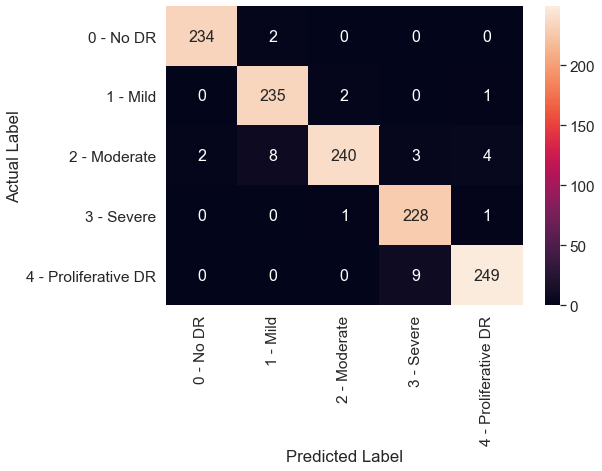

Accuracy: 0.9729286300246104
precision: 0.9733734918328527
recall: 0.9729286300246104
fscore: 0.9728624113368669
QWK Score: 0.9879371526339897



 Predicting labels using validation dataset




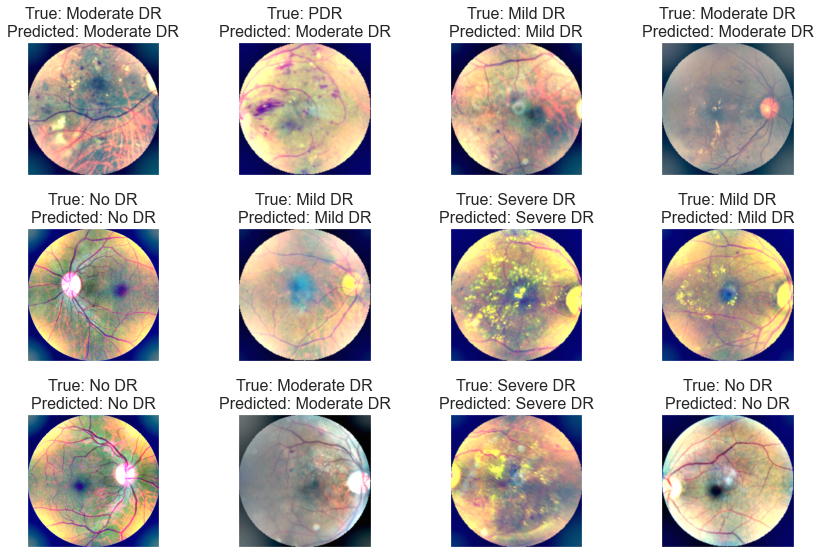

In [115]:
performace_evaluate(modelEns)

39/39 [==============================] - 55s 1s/step - loss: 0.0823 - accuracy: 0.9729
Validation: accuracy = 0.972929  ;  loss_v = 0.082309
Train: accuracy = 0.988411  ;  loss = 0.042748


Time taken for predicting the model: 58.53504 seconds

 Confusion Matrix 

[[234   2   0   0   0]
 [  0 235   2   0   1]
 [  2   8 240   3   4]
 [  0   0   1 228   1]
 [  0   0   0   9 249]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       236
           1       0.96      0.99      0.98       238
           2       0.99      0.92      0.95       257
           3       0.95      0.98      0.97       230
           4       0.98      0.97      0.97       258

   micro avg       0.97      0.97      0.97      1219
   macro avg       0.97      0.97      0.97      1219
weighted avg       0.97      0.97      0.97      1219
 samples avg       0.97      0.97      0.97      1219



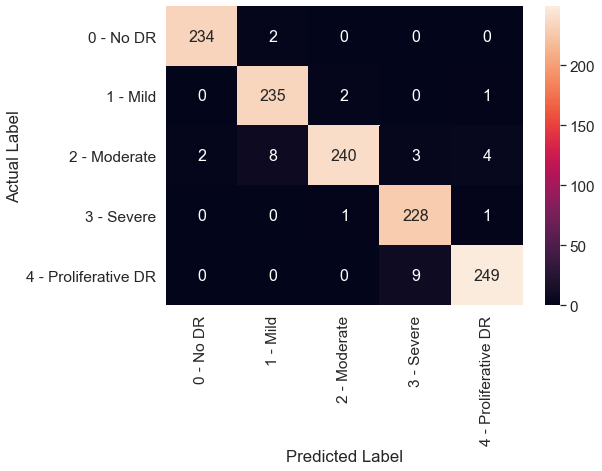

Accuracy: 0.9729286300246104
precision: 0.9733734918328527
recall: 0.9729286300246104
fscore: 0.9728624113368669
QWK Score: 0.9879371526339897



 Predicting labels using validation dataset




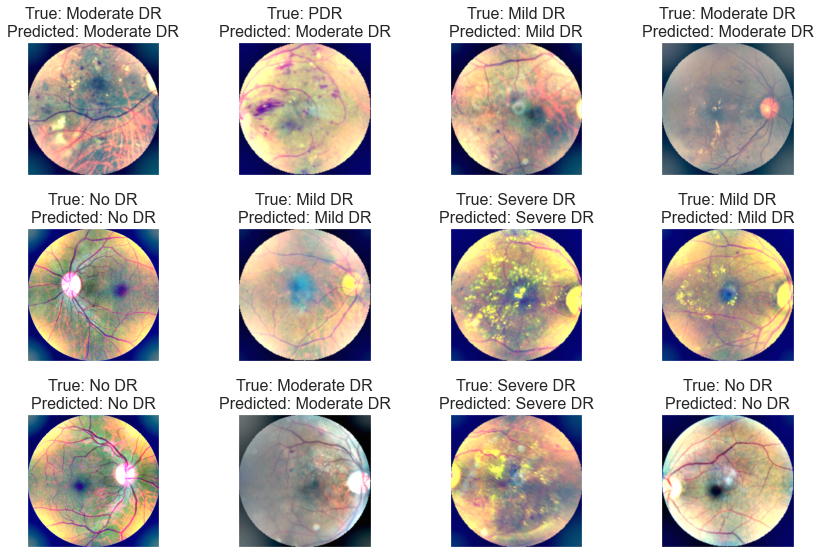

In [107]:
performace_evaluate(modelEns)

In [116]:
modelEns.save('modelEns_all_full.h5')

##  Evaluate Performance on Unseen Test Dataset



Time taken for predicting the model: 42.67996 seconds

 Confusion Matrix 

[[193   1   1   0   0]
 [  1 167   4   0   2]
 [  3   4 157   0   5]
 [  0   0   1 171   2]
 [  0   0   0   4 187]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.99      0.98      0.99       195
           1       0.97      0.96      0.97       174
           2       0.97      0.92      0.94       169
           3       0.98      0.98      0.98       174
           4       0.96      0.98      0.97       191

   micro avg       0.98      0.97      0.97       903
   macro avg       0.98      0.96      0.97       903
weighted avg       0.98      0.97      0.97       903
 samples avg       0.97      0.97      0.97       903



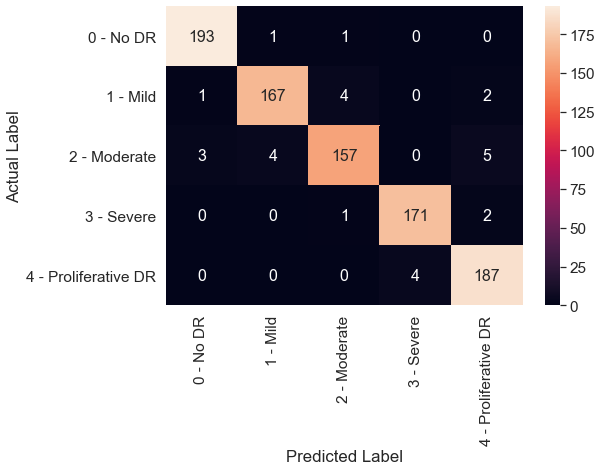

Accuracy: 0.9689922480620154
precision: 0.9690078180355022
recall: 0.9689922480620154
fscore: 0.9688947745521318
QWK Score: 0.981369805852298



 Predicting labels using validation dataset




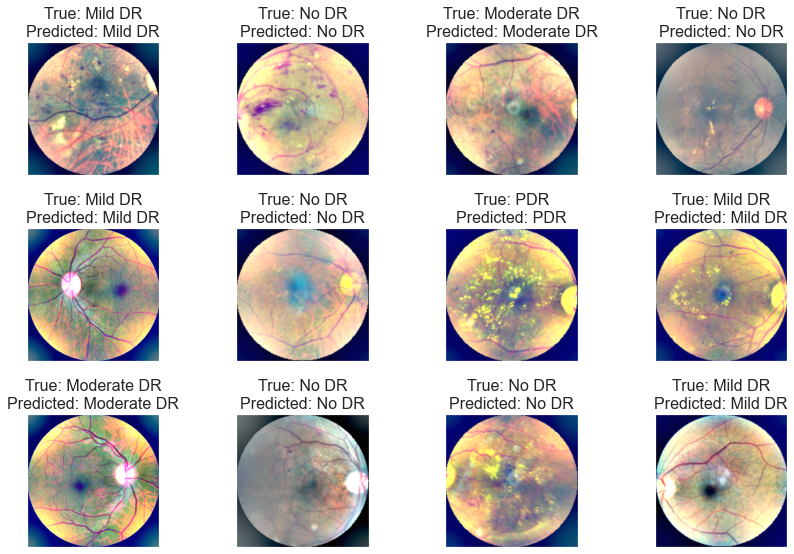

In [117]:
test_prediction(modelEns)

##  Make prediction on Test Dataset



61/61 [==============================] - 91s 1s/step

 Distribution of predicted label 



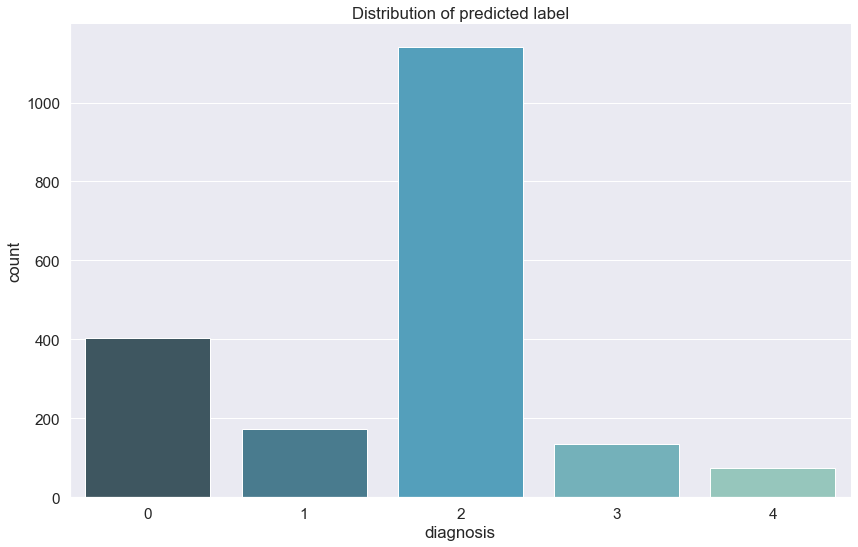




 Predicting labels using Test dataset




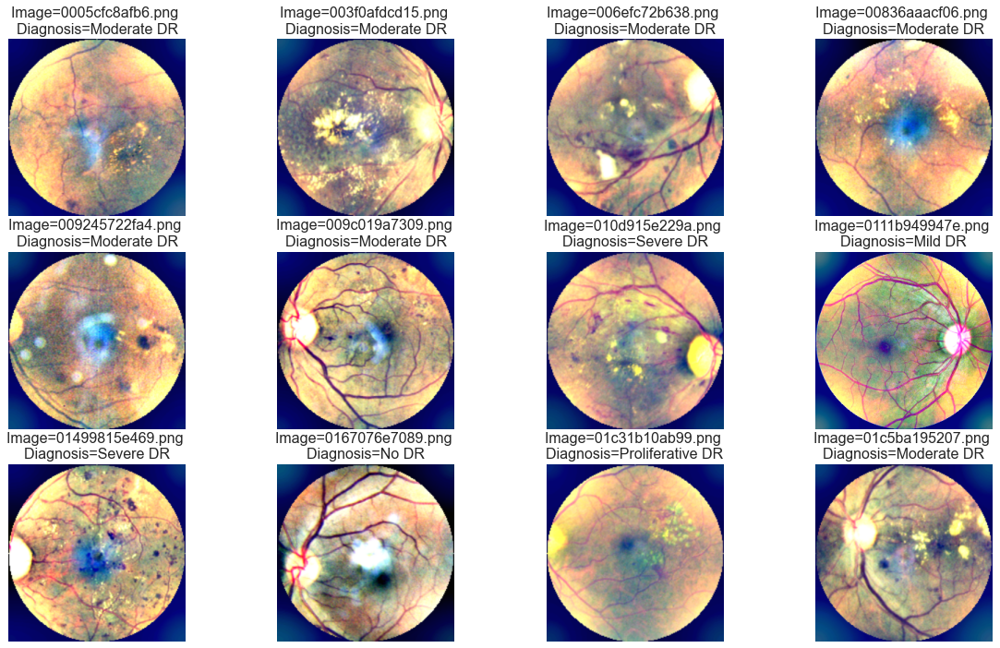

In [118]:

predict_labels(modelEns)

### Ensemble model - Except ResNet50

In [122]:
all_models_R= [vgg_FT,densenet_FT,incept_FT,incep_res_FT,xceptnet_FT]
model_input_R = Input(shape=all_models_R[0].input_shape[1:]) # c*h*w
modelEns_R = ensembleModels(all_models_R, model_input_R,"Ensemble_ExRes")

In [123]:
optimizer = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=True)
modelEns_R.compile(loss='categorical_crossentropy',
            optimizer=optimizer,
            metrics=['accuracy'])

39/39 [==============================] - 53s 1s/step - loss: 0.0874 - accuracy: 0.9737
Validation: accuracy = 0.973749  ;  loss_v = 0.087371
Train: accuracy = 0.987976  ;  loss = 0.046581


Time taken for predicting the model: 64.13543 seconds

 Confusion Matrix 

[[234   2   0   0   0]
 [  0 235   2   0   1]
 [  2  10 240   2   3]
 [  0   0   0 229   1]
 [  0   0   0   9 249]]

 Classification Report 

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       236
           1       0.96      0.98      0.97       238
           2       0.99      0.91      0.95       257
           3       0.96      0.99      0.97       230
           4       0.98      0.96      0.97       258

   micro avg       0.98      0.97      0.97      1219
   macro avg       0.98      0.97      0.97      1219
weighted avg       0.98      0.97      0.97      1219
 samples avg       0.97      0.97      0.97      1219



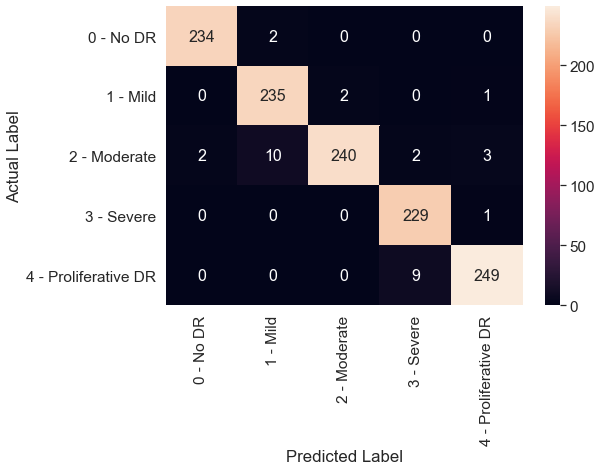

Accuracy: 0.9737489745693191
precision: 0.9743173693168721
recall: 0.9737489745693191
fscore: 0.9736887417472646
QWK Score: 0.9887509163108106



 Predicting labels using validation dataset




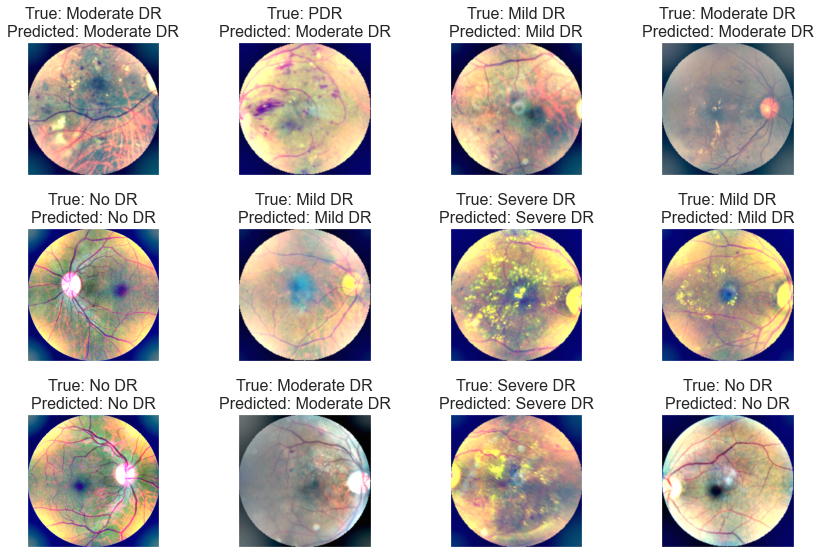

In [124]:
performace_evaluate(modelEns_R)

In [168]:
modelEns_R.save('modelEns_R.h5')

## Ensemble model - Except DenseNet201

In [130]:
all_models_D= [vgg_FT,resnet_FT,incept_FT,incep_res_FT,xceptnet_FT]
model_input_D = Input(shape=all_models_D[0].input_shape[1:]) # c*h*w
modelEns_D = ensembleModels(all_models_D, model_input_D,"Ensemble_ExDense")

In [131]:
optimizer = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=True)
modelEns_D.compile(loss='categorical_crossentropy',
            optimizer=optimizer,
            metrics=['accuracy'])

39/39 [==============================] - 48s 1s/step - loss: 0.0747 - accuracy: 0.9779
Validation: accuracy = 0.977851  ;  loss_v = 0.074686
Train: accuracy = 0.990294  ;  loss = 0.036903


Time taken for predicting the model: 54.5668 seconds

 Confusion Matrix 

[[234   2   0   0   0]
 [  0 235   2   0   1]
 [  0   6 245   3   3]
 [  0   0   1 228   1]
 [  0   0   0   8 250]]

 Classification Report 

              precision    recall  f1-score   support

           0       1.00      0.99      1.00       236
           1       0.97      0.99      0.98       238
           2       0.99      0.94      0.96       257
           3       0.95      0.99      0.97       230
           4       0.98      0.97      0.98       258

   micro avg       0.98      0.97      0.98      1219
   macro avg       0.98      0.98      0.98      1219
weighted avg       0.98      0.97      0.98      1219
 samples avg       0.97      0.97      0.97      1219



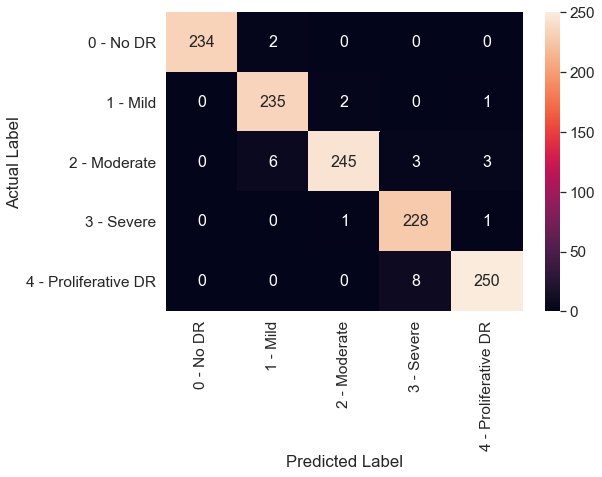

Accuracy: 0.977850697292863
precision: 0.9781879741573148
recall: 0.977850697292863
fscore: 0.9778555993857755
QWK Score: 0.9909831548602301



 Predicting labels using validation dataset




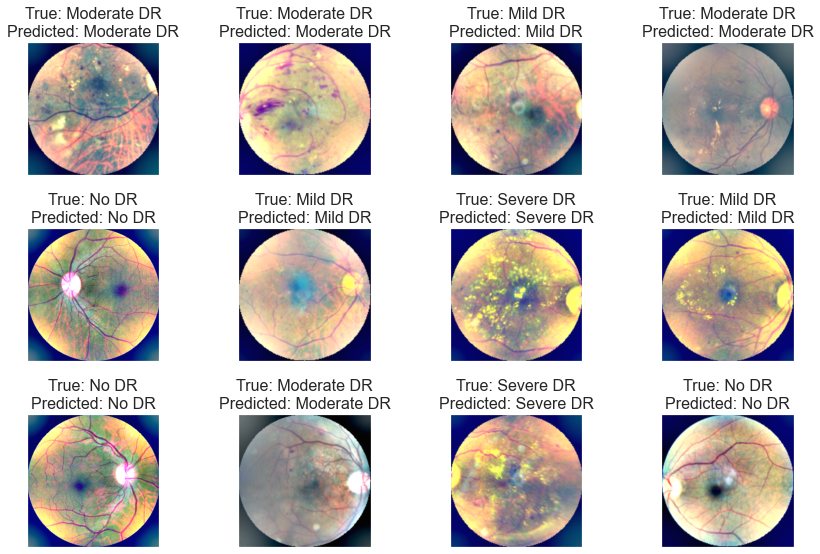

In [132]:
performace_evaluate(modelEns_D)



Time taken for predicting the model: 30.97102 seconds

 Confusion Matrix 

[[193   1   1   0   0]
 [  0 169   3   0   2]
 [  3   6 155   0   5]
 [  0   0   1 172   1]
 [  0   0   0   3 188]]

 Classification Report 

              precision    recall  f1-score   support

           0       1.00      0.98      0.99       195
           1       0.96      0.97      0.96       174
           2       0.97      0.89      0.93       169
           3       0.98      0.99      0.99       174
           4       0.96      0.98      0.97       191

   micro avg       0.98      0.96      0.97       903
   macro avg       0.97      0.96      0.97       903
weighted avg       0.98      0.96      0.97       903
 samples avg       0.96      0.96      0.96       903



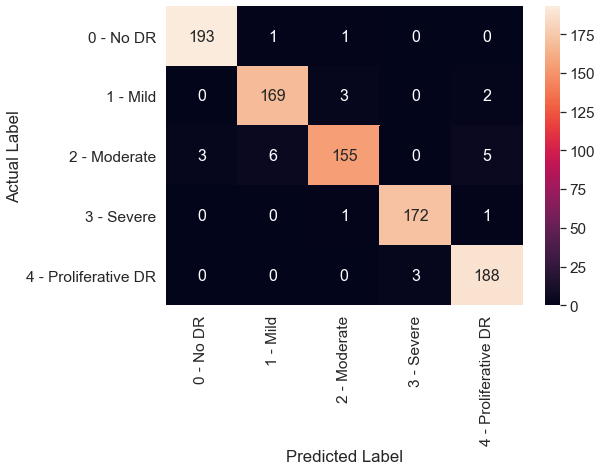

Accuracy: 0.9712070874861573
precision: 0.9712456545590147
recall: 0.9712070874861573
fscore: 0.971050967787411
QWK Score: 0.9818944316957723



 Predicting labels using validation dataset




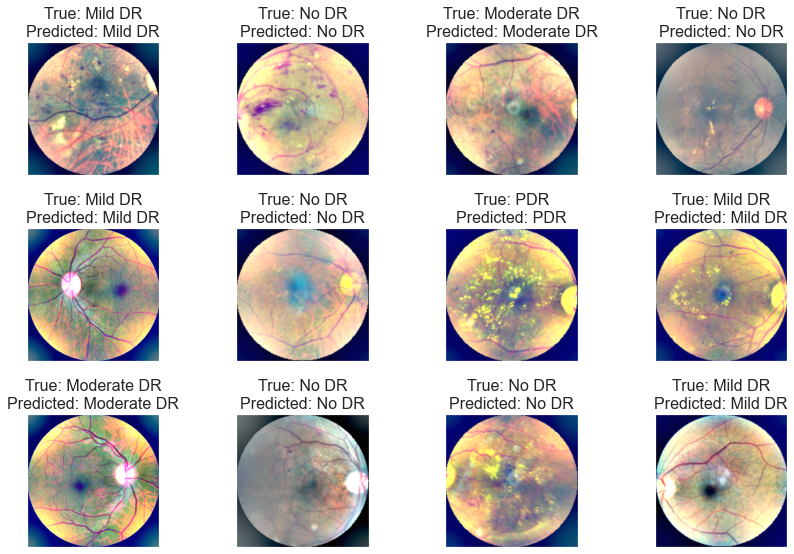

In [133]:
test_prediction(modelEns_D)

61/61 [==============================] - 72s 1s/step

 Distribution of predicted label 



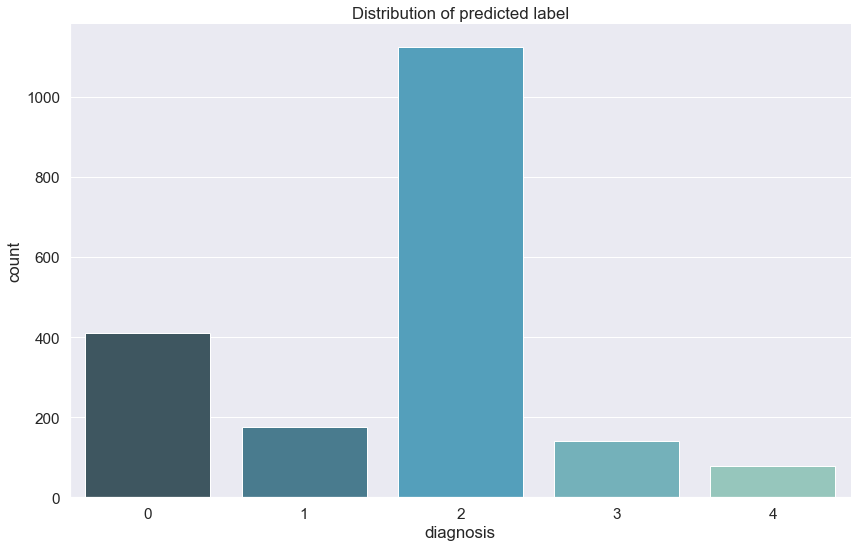




 Predicting labels using Test dataset




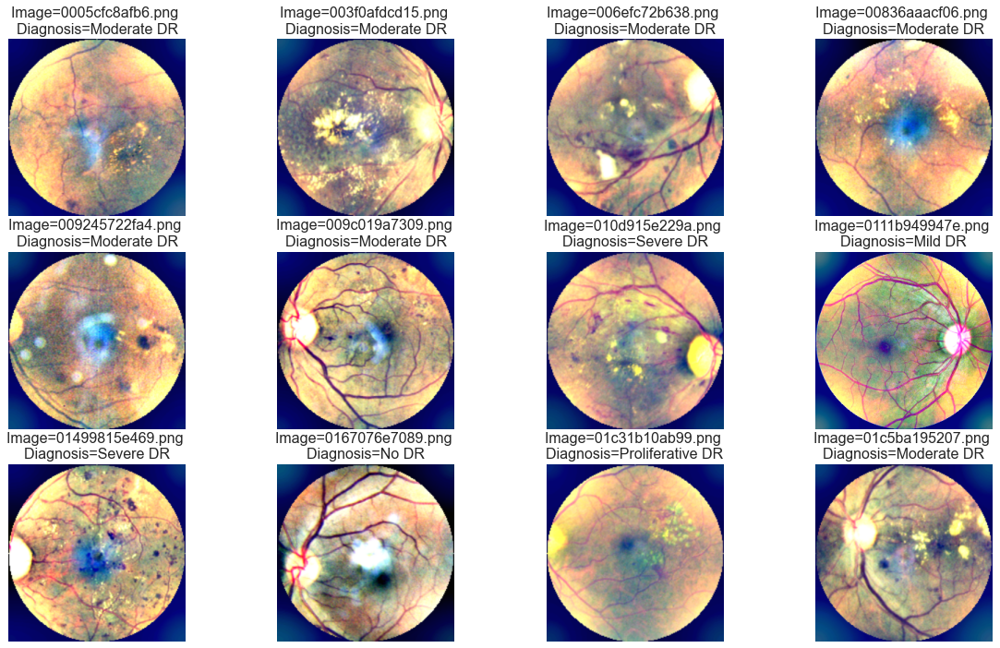

In [134]:

predict_labels(modelEns_D)

In [167]:
modelEns_D.save('modelEns_D.h5')

In [55]:
y_test_pred = modelEns.predict(x_test_pred,verbose=1)
predictions = [np.argmax(pred) for pred in y_test_pred]

61/61 [==============================] - 97s 2s/step


In [56]:
test = pd.read_csv('/Volumes/surya/aptos2019-blindness-detection/test.csv')

In [57]:
test['diagnosis'] = predictions
test.to_csv('modelEnsemble.csv',index=False)
test

,id_code,diagnosis
0,0005cfc8afb6,2
1,003f0afdcd15,2
2,006efc72b638,4
3,00836aaacf06,2
4,009245722fa4,2
...,...,...
1923,ff2fd94448de,0
1924,ff4c945d9b17,2
1925,ff64897ac0d8,2
1926,ffa73465b705,4


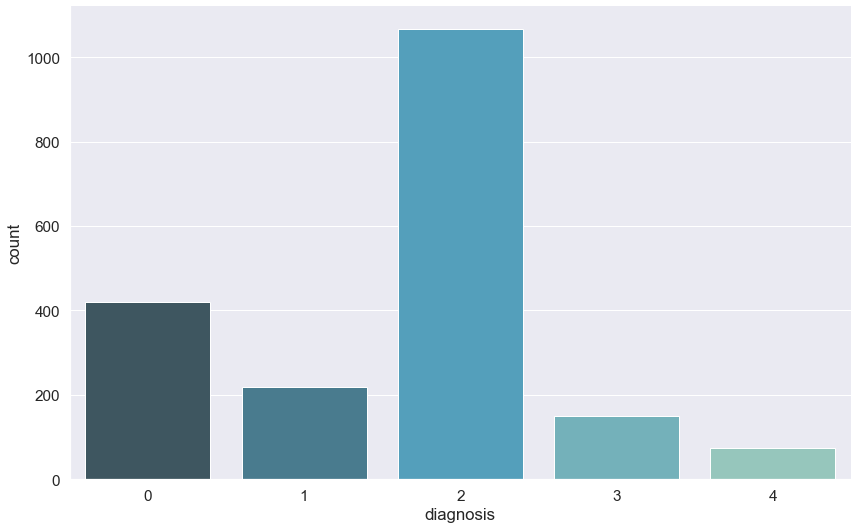

In [58]:
import seaborn as sns
import matplotlib.pyplot as plt
f, ax = plt.subplots(figsize=(14, 8.7))
ax = sns.countplot(x="diagnosis", data=test, palette="GnBu_d")
sns.despine()
plt.show()

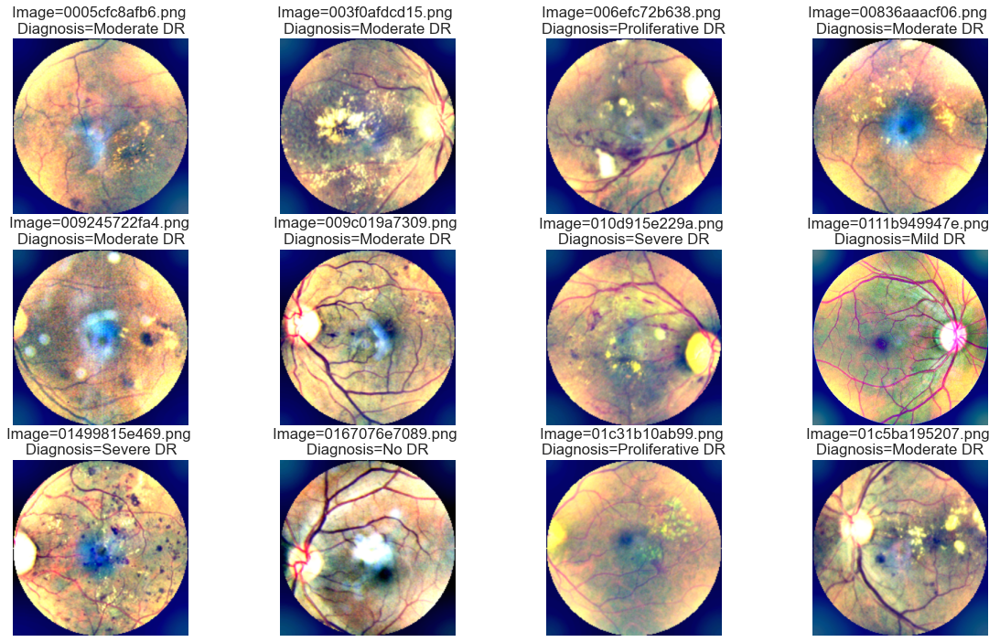

In [59]:
#def display_samples(df,
columns=4
rows=3

fig=plt.figure(figsize=(5*columns, 4*rows))
#fig=plt.figure(figsize=(15, 8))
for i in range(columns*rows):
    image_path = test.loc[i,'id_code']
    #print(image_path)
    image_id = test.loc[i,'diagnosis']
    if image_id==0:
        val="No DR"
    elif image_id==1:
        val="Mild DR"
    elif image_id==2:
        val="Moderate DR"
    elif image_id==3:
        val="Severe DR"   
    elif image_id==4:
        val="Proliferative DR"    
    img = cv2.imread(f'G/APTOS/test-final-256/{image_path}.png')
    #print(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    fig.add_subplot(rows, columns, i+1)
    #plt.title(["Image:" image_path "Label = "+image_id])
    plt.title("Image={image_path}.png \nDiagnosis={image_id}".format(image_path=image_path, image_id=val))
    #plt.title(image_path)
    #plt.title(image_id)
    plt.axis('off')
    plt.imshow(img)

### COMPARISON WITH OTHER WORKS

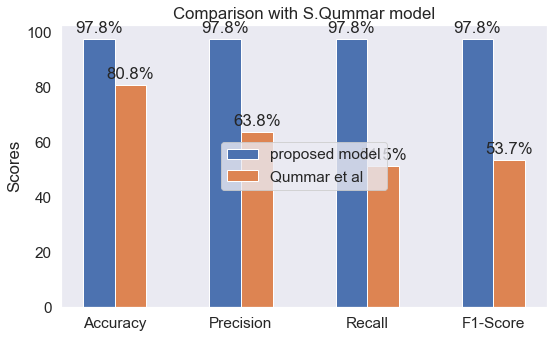

In [157]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np


labels = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
model = [97.8, 97.8, 97.8, 97.8]
model_qumar = [80.8, 63.8, 51.5, 53.7]

x = np.arange(len(labels))  # the label locations
width = 0.25  # the width of the bars


#fig, ax = plt.subplots()
fig, ax = plt.subplots(figsize=(8, 5))
rects1 = ax.bar(x - width/2, model, width, label='proposed model')
rects2 = ax.bar(x + width/2, model_qumar, width, label='Qummar et al')


# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Scores')
ax.set_title('Comparison with S.Qummar model')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend(loc='center')


def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}%'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')


autolabel(rects1)
autolabel(rects2)

fig.tight_layout()

plt.show()

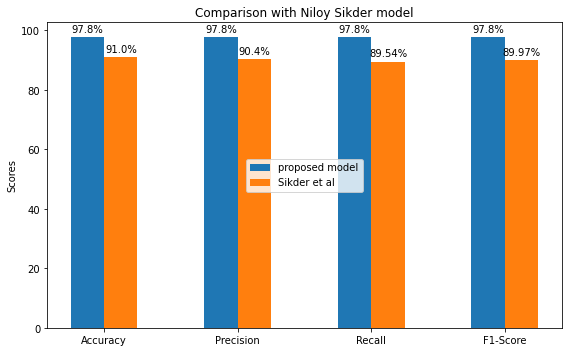

In [4]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np


labels = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
model = [97.8, 97.8, 97.8, 97.8]
model_qumar = [91, 90.4, 89.54, 89.97]

x = np.arange(len(labels))  # the label locations
width = 0.25  # the width of the bars


#fig, ax = plt.subplots()
fig, ax = plt.subplots(figsize=(8, 5))
rects1 = ax.bar(x - width/2, model, width, label='proposed model')
rects2 = ax.bar(x + width/2, model_qumar, width, label='Sikder et al')


# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Scores')
ax.set_title('Comparison with Niloy Sikder model')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend(loc='center')


def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}%'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')


autolabel(rects1)
autolabel(rects2)

fig.tight_layout()

plt.show()